In [ ]:
! pip install --upgrade gdown
! pip install facenet-pytorch

  Attempting uninstall: gdown
    Found existing installation: gdown 5.1.0
    Uninstalling gdown-5.1.0:
      Successfully uninstalled gdown-5.1.0
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.9/1.9 MB 5.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 4.5/4.5 MB 7.6 MB/s eta 0:00:00
  Using cached nvidia_cuda_nvrtc_cu12-12.1.105-py3-none-manylinux1_x86_64.whl (23.7 MB)
  Using cached nvidia_cuda_runtime_cu12-12.1.105-py3-none-manylinux1_x86_64.whl (823 kB)
  Using cached nvidia_cuda_cupti_cu12-12.1.105-py3-none-manylinux1_x86_64.whl (14.1 MB)
  Using cached nvidia_cudnn_cu12-8.9.2.26-py3-none-manylinux1_x86_64.whl (731.7 MB)
  Using cached nvidia_cublas_cu12-12.1.3.1-py3-none-manylinux1_x86_64.whl (410.6 MB)
  Using cached nvidia_cufft_cu12-11.0.2.54-py3-none-manylinux1_x86_64.whl (121.6 MB)
  Using cached nvidia_curand_cu12-10.3.2.106-py3-none-manylinux1_x86_64.whl (56.5 MB)
  Using cached nvidia_cusolver_cu12-11.4.5.107-py3-none-manylinux1_x86_64.whl (124.2 MB)
  

In [ ]:
import os
import cv2
import numpy as np
import matplotlib.pyplot as plt
from PIL import Image
from tqdm import tqdm
from facenet_pytorch import InceptionResnetV1
import torch
import torch.optim
import torch.nn as nn
import torch.nn.functional as F
from torch.utils.data import DataLoader, SubsetRandomSampler, Dataset, random_split, Subset
from torch import optim
from torch.utils.tensorboard import SummaryWriter
from torchvision import datasets, transforms


In [ ]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

In [ ]:
! gdown "1ez91uSjimI4eGg2WFCzkds1MzRzHkxGg"

Downloading...
From: https://drive.google.com/uc?id=1ez91uSjimI4eGg2WFCzkds1MzRzHkxGg
To: /content/Faces.zip
100% 7.53M/7.53M [00:00<00:00, 30.4MB/s]


In [ ]:
!unzip "Faces.zip"

Archive:  Faces.zip
   creating: Faces/
   creating: Faces/Alexandra Daddario/
  inflating: Faces/Alexandra Daddario/Alexandra Daddario_0.jpg  
  inflating: Faces/Alexandra Daddario/Alexandra Daddario_1.jpg  
  inflating: Faces/Alexandra Daddario/Alexandra Daddario_10.jpg  
  inflating: Faces/Alexandra Daddario/Alexandra Daddario_11.jpg  
  inflating: Faces/Alexandra Daddario/Alexandra Daddario_12.jpg  
  inflating: Faces/Alexandra Daddario/Alexandra Daddario_13.jpg  
  inflating: Faces/Alexandra Daddario/Alexandra Daddario_14.jpg  
  inflating: Faces/Alexandra Daddario/Alexandra Daddario_15.jpg  
  inflating: Faces/Alexandra Daddario/Alexandra Daddario_16.jpg  
  inflating: Faces/Alexandra Daddario/Alexandra Daddario_17.jpg  
  inflating: Faces/Alexandra Daddario/Alexandra Daddario_18.jpg  
  inflating: Faces/Alexandra Daddario/Alexandra Daddario_19.jpg  
  inflating: Faces/Alexandra Daddario/Alexandra Daddario_2.jpg  
  inflating: Faces/Alexandra Daddario/Alexandra Daddario_20.jpg  


In [ ]:
model = InceptionResnetV1(pretrained='vggface2')

  0%|          | 0.00/107M [00:00<?, ?B/s]

In [ ]:
# new_layers = nn.Sequential(
#     nn.Linear(in_features=model.logits.in_features, out_features=128),  # Adjust feature sizes
#     nn.ReLU(),
#     nn.Linear(128, 64),
#     nn.ReLU(),
#     nn.Linear(64, 14)
# )
# setattr(model, 'logits', new_layers)

In [ ]:
# model

InceptionResnetV1(
  (conv2d_1a): BasicConv2d(
    (conv): Conv2d(3, 32, kernel_size=(3, 3), stride=(2, 2), bias=False)
    (bn): BatchNorm2d(32, eps=0.001, momentum=0.1, affine=True, track_running_stats=True)
    (relu): ReLU()
  )
  (conv2d_2a): BasicConv2d(
    (conv): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), bias=False)
    (bn): BatchNorm2d(32, eps=0.001, momentum=0.1, affine=True, track_running_stats=True)
    (relu): ReLU()
  )
  (conv2d_2b): BasicConv2d(
    (conv): Conv2d(32, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
    (bn): BatchNorm2d(64, eps=0.001, momentum=0.1, affine=True, track_running_stats=True)
    (relu): ReLU()
  )
  (maxpool_3a): MaxPool2d(kernel_size=3, stride=2, padding=0, dilation=1, ceil_mode=False)
  (conv2d_3b): BasicConv2d(
    (conv): Conv2d(64, 80, kernel_size=(1, 1), stride=(1, 1), bias=False)
    (bn): BatchNorm2d(80, eps=0.001, momentum=0.1, affine=True, track_running_stats=True)
    (relu): ReLU()
  )
  (conv2d_4a): 

# **Data Loading**

In [ ]:
class CustomDataset(Dataset):
    def __init__(self, root_dir, transform=None):
        self.root_dir = root_dir
        self.transform = transform
        self.classes = os.listdir(root_dir)
        self.data = []

        for idx, class_name in enumerate(self.classes):
            class_path = os.path.join(self.root_dir, class_name)
            for img_name in os.listdir(class_path):
                img_path = os.path.join(class_path, img_name)
                self.data.append((img_path, idx))  # (image_path, class_index)

    def __len__(self):
        return len(self.data)

    def __getitem__(self, idx):
        img_path, label = self.data[idx]
        img = cv2.imread(img_path)
        if self.transform:
            img = self.transform(img)

        return img, label

root_dir = '/content/Faces'
# Define the transformations to apply to the images
transform = transforms.Compose([
    transforms.ToTensor()
])

# Create an instance of the CustomDataset class
dataset = CustomDataset(root_dir, transform=transform)

# Create a data loader to iterate over the dataset
train_dataset, test_dataset = random_split(dataset, [0.8, 0.2])
train_loader = torch.utils.data.DataLoader(train_dataset, batch_size=32, shuffle=True)
test_loader = torch.utils.data.DataLoader(test_dataset, batch_size=32, shuffle=True)


# **Complete FaceNet Freeze**

In [ ]:
class CustomModel(nn.Module):
    def __init__(self):
        super(CustomModel, self).__init__()
        self.embeddings = InceptionResnetV1(pretrained='vggface2').eval()
        for param in self.embeddings.parameters():
            param.requires_grad = False
        self.new_layer = nn.Sequential(
          nn.Linear(in_features=512, out_features=128),  # Adjust feature sizes
          nn.ReLU(),
          nn.Linear(128, 64),
          nn.ReLU(),
          nn.Linear(64, 14)
      )

    def forward(self, x):
        embeddings = self.embeddings(x)
        x = self.new_layer(embeddings)
        return x, embeddings

# Instantiate the model
model = CustomModel()

In [ ]:
num_epochs = 25
learning_rate = 0.0015
correct_predictions = 0
total_samples = 0
model.to(device)
criterion = nn.CrossEntropyLoss()
optimizer = optim.Adam(model.parameters(), lr=learning_rate)
# Training loop
for epoch in range(num_epochs):
    model.train()  # Set the model to training mode
    running_loss = 0.0

    # Iterate over the training dataset
    for images, labels in tqdm(train_loader, desc=f'Epoch {epoch + 1}/{num_epochs}', unit='batch'):
        # Zero the gradients
        optimizer.zero_grad()
        images = images.to(device)
        labels = labels.to(device)
        # Forward pass
        outputs,_ = model(images)

        # Calculate loss
        loss = criterion(outputs, labels)

        # Backward pass and optimize
        loss.backward()
        optimizer.step()

        # Update running loss
        running_loss += loss.item() * images.size(0)

        _, predicted = torch.max(outputs, 1)

        # Update total samples count
        total_samples += labels.size(0)

        # Update correct predictions count
        correct_predictions += (predicted == labels).sum().item()

    # Calculate accuracy
    accuracy = correct_predictions / total_samples
    print(f'Training Accuracy: {accuracy * 100:.2f}%')

    # Calculate average training loss for the epoch
    epoch_loss = running_loss / len(train_dataset)
    print(f'Training Loss: {epoch_loss:.4f}')

Epoch 1/25: 100%|██████████| 37/37 [00:02<00:00, 15.86batch/s]


Training Accuracy: 53.57%
Training Loss: 2.4185


Epoch 2/25: 100%|██████████| 37/37 [00:02<00:00, 15.54batch/s]


Training Accuracy: 72.09%
Training Loss: 0.9776


Epoch 3/25: 100%|██████████| 37/37 [00:02<00:00, 12.57batch/s]


Training Accuracy: 80.99%
Training Loss: 0.1429


Epoch 4/25: 100%|██████████| 37/37 [00:02<00:00, 16.23batch/s]


Training Accuracy: 85.42%
Training Loss: 0.0600


Epoch 5/25: 100%|██████████| 37/37 [00:02<00:00, 16.53batch/s]


Training Accuracy: 88.17%
Training Loss: 0.0442


Epoch 6/25: 100%|██████████| 37/37 [00:02<00:00, 16.41batch/s]


Training Accuracy: 90.05%
Training Loss: 0.0317


Epoch 7/25: 100%|██████████| 37/37 [00:02<00:00, 16.34batch/s]


Training Accuracy: 91.40%
Training Loss: 0.0275


Epoch 8/25: 100%|██████████| 37/37 [00:02<00:00, 13.48batch/s]


Training Accuracy: 92.38%
Training Loss: 0.0293


Epoch 9/25: 100%|██████████| 37/37 [00:02<00:00, 16.40batch/s]


Training Accuracy: 93.18%
Training Loss: 0.0229


Epoch 10/25: 100%|██████████| 37/37 [00:02<00:00, 16.52batch/s]


Training Accuracy: 93.81%
Training Loss: 0.0230


Epoch 11/25: 100%|██████████| 37/37 [00:02<00:00, 16.39batch/s]


Training Accuracy: 94.35%
Training Loss: 0.0170


Epoch 12/25: 100%|██████████| 37/37 [00:02<00:00, 13.66batch/s]


Training Accuracy: 94.78%
Training Loss: 0.0152


Epoch 13/25: 100%|██████████| 37/37 [00:02<00:00, 12.90batch/s]


Training Accuracy: 95.17%
Training Loss: 0.0136


Epoch 14/25: 100%|██████████| 37/37 [00:02<00:00, 16.07batch/s]


Training Accuracy: 95.50%
Training Loss: 0.0146


Epoch 15/25: 100%|██████████| 37/37 [00:02<00:00, 16.40batch/s]


Training Accuracy: 95.78%
Training Loss: 0.0128


Epoch 16/25: 100%|██████████| 37/37 [00:02<00:00, 16.43batch/s]


Training Accuracy: 96.04%
Training Loss: 0.0084


Epoch 17/25: 100%|██████████| 37/37 [00:02<00:00, 16.63batch/s]


Training Accuracy: 96.26%
Training Loss: 0.0108


Epoch 18/25: 100%|██████████| 37/37 [00:02<00:00, 13.14batch/s]


Training Accuracy: 96.46%
Training Loss: 0.0062


Epoch 19/25: 100%|██████████| 37/37 [00:02<00:00, 14.88batch/s]


Training Accuracy: 96.65%
Training Loss: 0.0075


Epoch 20/25: 100%|██████████| 37/37 [00:02<00:00, 15.20batch/s]


Training Accuracy: 96.80%
Training Loss: 0.0062


Epoch 21/25: 100%|██████████| 37/37 [00:02<00:00, 16.22batch/s]


Training Accuracy: 96.94%
Training Loss: 0.0101


Epoch 22/25: 100%|██████████| 37/37 [00:02<00:00, 15.33batch/s]


Training Accuracy: 97.06%
Training Loss: 0.0086


Epoch 23/25: 100%|██████████| 37/37 [00:02<00:00, 15.24batch/s]


Training Accuracy: 97.18%
Training Loss: 0.0114


Epoch 24/25: 100%|██████████| 37/37 [00:02<00:00, 14.41batch/s]


Training Accuracy: 97.29%
Training Loss: 0.0100


Epoch 25/25: 100%|██████████| 37/37 [00:02<00:00, 16.56batch/s]

Training Accuracy: 97.39%
Training Loss: 0.0041


In [ ]:
# Test
model.eval()
correct_preds = 0
total_samples = 0

# Disable gradient calculation during testing
with torch.no_grad():
    for images, labels in tqdm(test_loader, desc=f'Testing'):
        images = images.to(device)
        labels = labels.to(device)
        outputs, embeddings = model(images)
        _, predicted = torch.max(outputs, 1)
        total_samples += labels.size(0)
        correct_preds += (predicted == labels).sum().item()
accuracy = correct_preds / total_samples
print(f'Test Accuracy: {accuracy * 100:.1f}%')


Testing: 100%|██████████| 10/10 [00:00<00:00, 13.44it/s]

Test Accuracy: 97.93%
torch.Size([2, 512])
tensor([8, 3], device='cuda:0')


# **Complete FaceNet Freeze2 (softmax & dropout)**

In [ ]:
class CustomModel2(nn.Module):
    def __init__(self):
        super(CustomModel2, self).__init__()
        self.embeddings = InceptionResnetV1(pretrained='vggface2').eval()
        for param in self.embeddings.parameters():
            param.requires_grad = False
        self.new_layer = nn.Sequential(
            nn.Linear(in_features=512, out_features=128),
            nn.Dropout(p=0.2),
            nn.ReLU(),
            nn.Linear(128, 64),
            nn.ReLU(),
            nn.Linear(64, 14)
        )

    def forward(self, x):
        embeddings = self.embeddings(x)
        x = self.new_layer(embeddings)
        X = F.softmax(x, dim=1)
        return x, embeddings
model = CustomModel2()

In [ ]:
num_epochs = 25
learning_rate = 0.0015
correct_predictions = 0
total_samples = 0
model.to(device)
criterion = nn.CrossEntropyLoss()
optimizer = optim.Adam(model.parameters(), lr=learning_rate)
for epoch in range(num_epochs):
    model.train()
    running_loss = 0.0

    for images, labels in tqdm(train_loader, desc=f'Epoch {epoch + 1}/{num_epochs}', unit='batch'):
        optimizer.zero_grad()
        images = images.to(device)
        labels = labels.to(device)
        outputs,_ = model(images)
        loss = criterion(outputs, labels)
        loss.backward()
        optimizer.step()
        running_loss += loss.item() * images.size(0)

        _, predicted = torch.max(outputs, 1)
        total_samples += labels.size(0)
        correct_predictions += (predicted == labels).sum().item()

    accuracy = correct_predictions / total_samples
    print(f'Training Accuracy: {accuracy * 100:.2f}%')
    epoch_loss = running_loss / len(train_dataset)
    print(f'Training Loss: {epoch_loss:.4f}')

Epoch 1/25: 100%|██████████| 37/37 [00:02<00:00, 13.16batch/s]


Training Accuracy: 53.57%
Training Loss: 2.4438


Epoch 2/25: 100%|██████████| 37/37 [00:02<00:00, 15.54batch/s]


Training Accuracy: 71.75%
Training Loss: 1.0297


Epoch 3/25: 100%|██████████| 37/37 [00:02<00:00, 16.11batch/s]


Training Accuracy: 80.53%
Training Loss: 0.1558


Epoch 4/25: 100%|██████████| 37/37 [00:02<00:00, 16.08batch/s]


Training Accuracy: 84.95%
Training Loss: 0.0743


Epoch 5/25: 100%|██████████| 37/37 [00:02<00:00, 16.16batch/s]


Training Accuracy: 87.68%
Training Loss: 0.0584


Epoch 6/25: 100%|██████████| 37/37 [00:02<00:00, 13.99batch/s]


Training Accuracy: 89.56%
Training Loss: 0.0468


Epoch 7/25: 100%|██████████| 37/37 [00:02<00:00, 14.05batch/s]


Training Accuracy: 90.96%
Training Loss: 0.0346


Epoch 8/25: 100%|██████████| 37/37 [00:02<00:00, 16.22batch/s]


Training Accuracy: 92.01%
Training Loss: 0.0348


Epoch 9/25: 100%|██████████| 37/37 [00:02<00:00, 16.15batch/s]


Training Accuracy: 92.79%
Training Loss: 0.0320


Epoch 10/25: 100%|██████████| 37/37 [00:02<00:00, 15.98batch/s]


Training Accuracy: 93.46%
Training Loss: 0.0203


Epoch 11/25: 100%|██████████| 37/37 [00:02<00:00, 15.23batch/s]


Training Accuracy: 94.02%
Training Loss: 0.0201


Epoch 12/25: 100%|██████████| 37/37 [00:02<00:00, 12.82batch/s]


Training Accuracy: 94.49%
Training Loss: 0.0187


Epoch 13/25: 100%|██████████| 37/37 [00:02<00:00, 15.94batch/s]


Training Accuracy: 94.90%
Training Loss: 0.0131


Epoch 14/25: 100%|██████████| 37/37 [00:02<00:00, 16.01batch/s]


Training Accuracy: 95.23%
Training Loss: 0.0206


Epoch 15/25: 100%|██████████| 37/37 [00:02<00:00, 15.97batch/s]


Training Accuracy: 95.50%
Training Loss: 0.0227


Epoch 16/25: 100%|██████████| 37/37 [00:02<00:00, 16.08batch/s]


Training Accuracy: 95.72%
Training Loss: 0.0237


Epoch 17/25: 100%|██████████| 37/37 [00:02<00:00, 12.79batch/s]


Training Accuracy: 95.90%
Training Loss: 0.0408


Epoch 18/25: 100%|██████████| 37/37 [00:02<00:00, 15.00batch/s]


Training Accuracy: 96.08%
Training Loss: 0.0215


Epoch 19/25: 100%|██████████| 37/37 [00:02<00:00, 15.95batch/s]


Training Accuracy: 96.25%
Training Loss: 0.0302


Epoch 20/25: 100%|██████████| 37/37 [00:02<00:00, 15.88batch/s]


Training Accuracy: 96.42%
Training Loss: 0.0117


Epoch 21/25: 100%|██████████| 37/37 [00:02<00:00, 15.93batch/s]


Training Accuracy: 96.56%
Training Loss: 0.0146


Epoch 22/25: 100%|██████████| 37/37 [00:02<00:00, 14.21batch/s]


Training Accuracy: 96.69%
Training Loss: 0.0183


Epoch 23/25: 100%|██████████| 37/37 [00:02<00:00, 13.83batch/s]


Training Accuracy: 96.83%
Training Loss: 0.0068


Epoch 24/25: 100%|██████████| 37/37 [00:02<00:00, 16.00batch/s]


Training Accuracy: 96.96%
Training Loss: 0.0142


Epoch 25/25: 100%|██████████| 37/37 [00:02<00:00, 15.96batch/s]

Training Accuracy: 97.07%
Training Loss: 0.0085


In [ ]:
# Test
model.eval()
correct_preds = 0
total_samples = 0

with torch.no_grad():
    for images, labels in tqdm(test_loader, desc=f'Testing'):
        images = images.to(device)
        labels = labels.to(device)
        outputs, embeddings = model(images)
        _, predicted = torch.max(outputs, 1)
        total_samples += labels.size(0)
        correct_preds += (predicted == labels).sum().item()
accuracy = correct_preds / total_samples
print(f'Test Accuracy: {accuracy * 100:.1f}%')


Testing: 100%|██████████| 10/10 [00:00<00:00, 17.72it/s]

Test Accuracy: 98.3%


# **Partially FaceNet Freeze**

In [ ]:
import torch.nn.functional as F
class CustomModel3(nn.Module):
    def __init__(self):
        super(CustomModel3, self).__init__()
        self.embeddings = InceptionResnetV1(pretrained='vggface2').eval()
        for name, param in self.embeddings.named_parameters():
          if not name.startswith('last') and not name.startswith('block8'):
            param.requires_grad = False
        self.new_layer = nn.Sequential(
            nn.Linear(in_features=512, out_features=128),
            nn.ReLU(),
            nn.Dropout(p=0.25),
            nn.Linear(128, 64),
            nn.ReLU(),
            nn.Linear(64, 14)
        )

    def forward(self, x):
        embeddings = self.embeddings(x)
        x = self.new_layer(embeddings)
        X = F.softmax(x, dim=1)
        return x, embeddings
model_finetune = CustomModel3()

In [ ]:
for name, param in model_finetune.named_parameters():
  if param.requires_grad:
    print(name)


embeddings.block8.branch0.conv.weight
embeddings.block8.branch0.bn.weight
embeddings.block8.branch0.bn.bias
embeddings.block8.branch1.0.conv.weight
embeddings.block8.branch1.0.bn.weight
embeddings.block8.branch1.0.bn.bias
embeddings.block8.branch1.1.conv.weight
embeddings.block8.branch1.1.bn.weight
embeddings.block8.branch1.1.bn.bias
embeddings.block8.branch1.2.conv.weight
embeddings.block8.branch1.2.bn.weight
embeddings.block8.branch1.2.bn.bias
embeddings.block8.conv2d.weight
embeddings.block8.conv2d.bias
embeddings.last_linear.weight
embeddings.last_bn.weight
embeddings.last_bn.bias
new_layer.0.weight
new_layer.0.bias
new_layer.3.weight
new_layer.3.bias
new_layer.5.weight
new_layer.5.bias


In [ ]:
num_epochs = 25
learning_rate = 0.0015
correct_predictions = 0
total_samples = 0
model_finetune.to(device)
criterion = nn.CrossEntropyLoss()
optimizer = optim.Adam(model_finetune.parameters(), lr=learning_rate)

for epoch in range(num_epochs):
    model_finetune.train()
    running_loss = 0.0

    for images, labels in tqdm(train_loader, desc=f'Epoch {epoch + 1}/{num_epochs}', unit='batch'):
        optimizer.zero_grad()
        images = images.to(device)
        labels = labels.to(device)
        outputs,_ = model_finetune(images)
        loss = criterion(outputs, labels)
        loss.backward()
        optimizer.step()
        running_loss += loss.item() * images.size(0)
        _, predicted = torch.max(outputs, 1)
        total_samples += labels.size(0)
        correct_predictions += (predicted == labels).sum().item()

    accuracy = correct_predictions / total_samples
    print(f'Training Accuracy: {accuracy * 100:.2f}%')
    epoch_loss = running_loss / len(train_dataset)
    print(f'Training Loss: {epoch_loss:.4f}')

Epoch 1/25: 100%|██████████| 37/37 [00:02<00:00, 13.52batch/s]


Training Accuracy: 45.48%
Training Loss: 2.1864


Epoch 2/25: 100%|██████████| 37/37 [00:02<00:00, 16.21batch/s]


Training Accuracy: 68.04%
Training Loss: 0.6536


Epoch 3/25: 100%|██████████| 37/37 [00:02<00:00, 15.93batch/s]


Training Accuracy: 77.09%
Training Loss: 0.2169


Epoch 4/25: 100%|██████████| 37/37 [00:02<00:00, 15.95batch/s]


Training Accuracy: 82.11%
Training Loss: 0.1233


Epoch 5/25: 100%|██████████| 37/37 [00:02<00:00, 15.34batch/s]


Training Accuracy: 85.39%
Training Loss: 0.0700


Epoch 6/25: 100%|██████████| 37/37 [00:02<00:00, 13.51batch/s]


Training Accuracy: 87.58%
Training Loss: 0.0614


Epoch 7/25: 100%|██████████| 37/37 [00:02<00:00, 16.11batch/s]


Training Accuracy: 89.02%
Training Loss: 0.0717


Epoch 8/25: 100%|██████████| 37/37 [00:02<00:00, 15.36batch/s]


Training Accuracy: 90.04%
Training Loss: 0.0893


Epoch 9/25: 100%|██████████| 37/37 [00:02<00:00, 14.19batch/s]


Training Accuracy: 91.05%
Training Loss: 0.0400


Epoch 10/25: 100%|██████████| 37/37 [00:02<00:00, 15.34batch/s]


Training Accuracy: 91.89%
Training Loss: 0.0225


Epoch 11/25: 100%|██████████| 37/37 [00:02<00:00, 13.39batch/s]


Training Accuracy: 92.60%
Training Loss: 0.0283


Epoch 12/25: 100%|██████████| 37/37 [00:02<00:00, 15.72batch/s]


Training Accuracy: 93.18%
Training Loss: 0.0253


Epoch 13/25: 100%|██████████| 37/37 [00:02<00:00, 15.72batch/s]


Training Accuracy: 93.64%
Training Loss: 0.0391


Epoch 14/25: 100%|██████████| 37/37 [00:02<00:00, 15.80batch/s]


Training Accuracy: 94.00%
Training Loss: 0.0566


Epoch 15/25: 100%|██████████| 37/37 [00:02<00:00, 15.70batch/s]


Training Accuracy: 94.36%
Training Loss: 0.0341


Epoch 16/25: 100%|██████████| 37/37 [00:02<00:00, 13.22batch/s]


Training Accuracy: 94.67%
Training Loss: 0.0283


Epoch 17/25: 100%|██████████| 37/37 [00:02<00:00, 15.70batch/s]


Training Accuracy: 94.93%
Training Loss: 0.0276


Epoch 18/25: 100%|██████████| 37/37 [00:02<00:00, 15.91batch/s]


Training Accuracy: 95.18%
Training Loss: 0.0143


Epoch 19/25: 100%|██████████| 37/37 [00:02<00:00, 15.93batch/s]


Training Accuracy: 95.42%
Training Loss: 0.0112


Epoch 20/25: 100%|██████████| 37/37 [00:02<00:00, 15.87batch/s]


Training Accuracy: 95.63%
Training Loss: 0.0130


Epoch 21/25: 100%|██████████| 37/37 [00:02<00:00, 13.58batch/s]


Training Accuracy: 95.82%
Training Loss: 0.0106


Epoch 22/25: 100%|██████████| 37/37 [00:02<00:00, 14.74batch/s]


Training Accuracy: 95.98%
Training Loss: 0.0222


Epoch 23/25: 100%|██████████| 37/37 [00:02<00:00, 15.91batch/s]


Training Accuracy: 96.11%
Training Loss: 0.0477


Epoch 24/25: 100%|██████████| 37/37 [00:02<00:00, 15.82batch/s]


Training Accuracy: 96.24%
Training Loss: 0.0391


Epoch 25/25: 100%|██████████| 37/37 [00:02<00:00, 15.98batch/s]

Training Accuracy: 96.33%
Training Loss: 0.0793


In [ ]:
# Test
model_finetune.eval()
correct_preds = 0
total_samples = 0

# Disable gradient calculation during testing
with torch.no_grad():
    for images, labels in tqdm(test_loader, desc=f'Testing'):
        images = images.to(device)
        labels = labels.to(device)
        outputs, embeddings = model_finetune(images)
        _, predicted = torch.max(outputs, 1)
        total_samples += labels.size(0)
        correct_preds += (predicted == labels).sum().item()
accuracy = correct_preds / total_samples
print(f'Test Accuracy: {accuracy * 100:.1f}%')


Testing: 100%|██████████| 10/10 [00:00<00:00, 15.29it/s]

Test Accuracy: 97.9%


# **Partially FaceNet Freeze2**

In [ ]:
class CustomModel4(nn.Module):
    def __init__(self):
        super(CustomModel4, self).__init__()
        self.embeddings = InceptionResnetV1(pretrained='vggface2').eval()
        for name, param in self.embeddings.named_parameters():
          if not name.startswith('last') and not name.startswith('block8'):
            param.requires_grad = False
        self.new_layer = nn.Sequential(
            nn.Linear(in_features=512, out_features=256),
            nn.Dropout(p=0.2),  # Adding Dropout
            nn.ReLU(),
            nn.Linear(256, 64),
            nn.Dropout(p=0.12),
            nn.ReLU(),
            nn.Linear(64, 14)
        )

    def forward(self, x):
        embeddings = self.embeddings(x)
        x = self.new_layer(embeddings)
        X = F.softmax(x, dim=1)
        return x, embeddings
model_finetune2 = CustomModel4()

In [ ]:
num_epochs = 25
learning_rate = 0.00125
correct_predictions = 0
total_samples = 0
model_finetune2.to(device)
criterion = nn.CrossEntropyLoss()
optimizer = optim.Adam(model_finetune2.parameters(), lr=learning_rate)
# Training loop
for epoch in range(num_epochs):
    model_finetune2.train()  # Set the model to training mode
    running_loss = 0.0

    # Iterate over the training dataset
    for images, labels in tqdm(train_loader, desc=f'Epoch {epoch + 1}/{num_epochs}', unit='batch'):
        # Zero the gradients
        optimizer.zero_grad()
        images = images.to(device)
        labels = labels.to(device)
        # Forward pass
        outputs,_ = model_finetune2(images)

        # Calculate loss
        loss = criterion(outputs, labels)

        # Backward pass and optimize
        loss.backward()
        optimizer.step()

        # Update running loss
        running_loss += loss.item() * images.size(0)

        _, predicted = torch.max(outputs, 1)

        # Update total samples count
        total_samples += labels.size(0)

        # Update correct predictions count
        correct_predictions += (predicted == labels).sum().item()

    # Calculate accuracy
    accuracy = correct_predictions / total_samples
    print(f'Training Accuracy: {accuracy * 100:.2f}%')

    # Calculate average training loss for the epoch
    epoch_loss = running_loss / len(train_dataset)
    print(f'Training Loss: {epoch_loss:.4f}')
# Test
model_finetune2.eval()
correct_preds = 0
total_samples = 0
with torch.no_grad():
    for images, labels in tqdm(test_loader, desc=f'Testing'):
        images = images.to(device)
        labels = labels.to(device)
        outputs, embeddings = model_finetune2(images)
        _, predicted = torch.max(outputs, 1)
        total_samples += labels.size(0)
        correct_preds += (predicted == labels).sum().item()
accuracy = correct_preds / total_samples
print(f'Test Accuracy: {accuracy * 100:.1f}%')


Epoch 1/25: 100%|██████████| 37/37 [00:04<00:00,  7.87batch/s]


Training Accuracy: 51.94%
Training Loss: 2.1380


Epoch 2/25: 100%|██████████| 37/37 [00:04<00:00,  8.76batch/s]


Training Accuracy: 72.74%
Training Loss: 0.4606


Epoch 3/25: 100%|██████████| 37/37 [00:02<00:00, 15.58batch/s]


Training Accuracy: 80.79%
Training Loss: 0.1429


Epoch 4/25: 100%|██████████| 37/37 [00:02<00:00, 15.51batch/s]


Training Accuracy: 85.06%
Training Loss: 0.1012


Epoch 5/25: 100%|██████████| 37/37 [00:02<00:00, 15.34batch/s]


Training Accuracy: 87.72%
Training Loss: 0.0661


Epoch 6/25: 100%|██████████| 37/37 [00:02<00:00, 14.27batch/s]


Training Accuracy: 89.56%
Training Loss: 0.0515


Epoch 7/25: 100%|██████████| 37/37 [00:02<00:00, 13.28batch/s]


Training Accuracy: 90.98%
Training Loss: 0.0196


Epoch 8/25: 100%|██████████| 37/37 [00:02<00:00, 15.44batch/s]


Training Accuracy: 92.08%
Training Loss: 0.0160


Epoch 9/25: 100%|██████████| 37/37 [00:02<00:00, 15.33batch/s]


Training Accuracy: 92.86%
Training Loss: 0.0383


Epoch 10/25: 100%|██████████| 37/37 [00:02<00:00, 15.69batch/s]


Training Accuracy: 93.45%
Training Loss: 0.0504


Epoch 11/25: 100%|██████████| 37/37 [00:02<00:00, 14.57batch/s]


Training Accuracy: 94.00%
Training Loss: 0.0215


Epoch 12/25: 100%|██████████| 37/37 [00:03<00:00, 11.54batch/s]


Training Accuracy: 94.46%
Training Loss: 0.0188


Epoch 13/25: 100%|██████████| 37/37 [00:02<00:00, 15.66batch/s]


Training Accuracy: 94.82%
Training Loss: 0.0287


Epoch 14/25: 100%|██████████| 37/37 [00:02<00:00, 15.47batch/s]


Training Accuracy: 95.18%
Training Loss: 0.0097


Epoch 15/25: 100%|██████████| 37/37 [00:02<00:00, 15.75batch/s]


Training Accuracy: 95.43%
Training Loss: 0.0441


Epoch 16/25: 100%|██████████| 37/37 [00:02<00:00, 14.76batch/s]


Training Accuracy: 95.67%
Training Loss: 0.0239


Epoch 17/25: 100%|██████████| 37/37 [00:02<00:00, 12.91batch/s]


Training Accuracy: 95.90%
Training Loss: 0.0196


Epoch 18/25: 100%|██████████| 37/37 [00:02<00:00, 13.63batch/s]


Training Accuracy: 96.10%
Training Loss: 0.0126


Epoch 19/25: 100%|██████████| 37/37 [00:02<00:00, 14.68batch/s]


Training Accuracy: 96.28%
Training Loss: 0.0261


Epoch 20/25: 100%|██████████| 37/37 [00:02<00:00, 15.64batch/s]


Training Accuracy: 96.32%
Training Loss: 0.0891


Epoch 21/25: 100%|██████████| 37/37 [00:02<00:00, 14.58batch/s]


Training Accuracy: 96.46%
Training Loss: 0.0211


Epoch 22/25: 100%|██████████| 37/37 [00:02<00:00, 13.26batch/s]


Training Accuracy: 96.60%
Training Loss: 0.0149


Epoch 23/25: 100%|██████████| 37/37 [00:02<00:00, 15.70batch/s]


Training Accuracy: 96.71%
Training Loss: 0.0365


Epoch 24/25: 100%|██████████| 37/37 [00:02<00:00, 15.46batch/s]


Training Accuracy: 96.81%
Training Loss: 0.0318


Epoch 25/25: 100%|██████████| 37/37 [00:02<00:00, 15.59batch/s]


Training Accuracy: 96.93%
Training Loss: 0.0111


Testing: 100%|██████████| 10/10 [00:00<00:00, 16.51it/s]

Test Accuracy: 99.0%


# **Face Verifier model_finetune2**

In [ ]:
def calculate_embedding(image, model):
    model = model.to(image.device)
    _, embeddings = model(image)

    return embeddings.cpu()

In [ ]:
test_size = len(test_dataset)
split_idx = test_size // 5
print(split_idx)
test_subset = Subset(test_dataset, range(split_idx))  # First half of test_dataset
known_data, unknown_data = random_split(test_subset, [0.5, 0.5])
known_data = DataLoader(known_data)
unknown_data = DataLoader(unknown_data)


58


# Euclidian

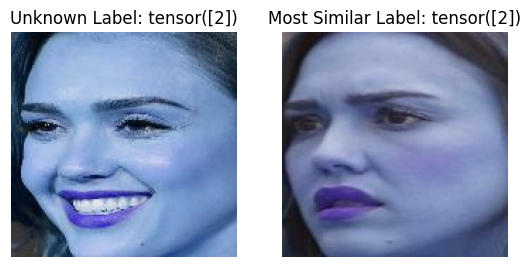

Label is: tensor([2]) and we achived: tensor([2]) the distance is: 0.15147538483142853


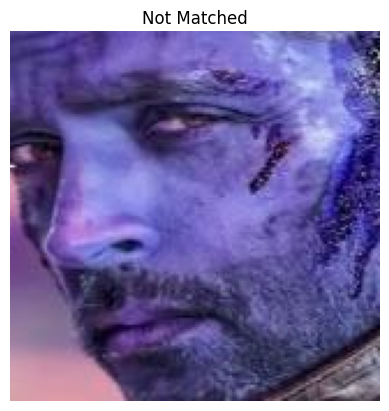

Label is: tensor([3]) and we achived: None the closest is: 0.9712256789207458


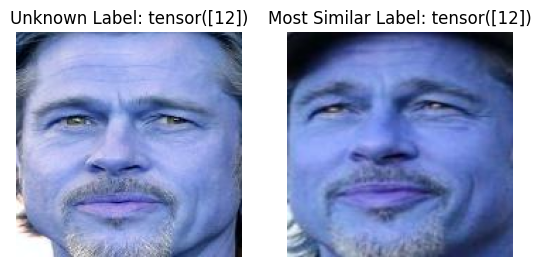

Label is: tensor([12]) and we achived: tensor([12]) the distance is: 0.15224073827266693


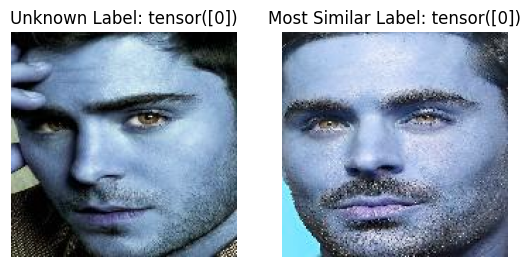

Label is: tensor([0]) and we achived: tensor([0]) the distance is: 0.24436840415000916


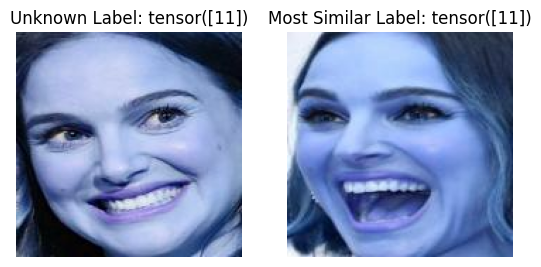

Label is: tensor([11]) and we achived: tensor([11]) the distance is: 0.16732023656368256


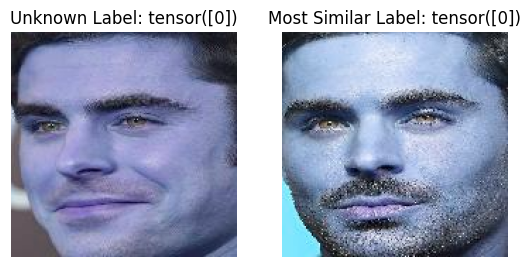

Label is: tensor([0]) and we achived: tensor([0]) the distance is: 0.1304459273815155


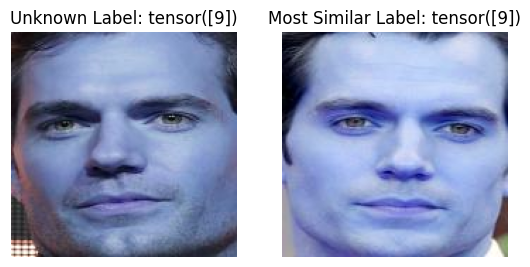

Label is: tensor([9]) and we achived: tensor([9]) the distance is: 0.09733396023511887


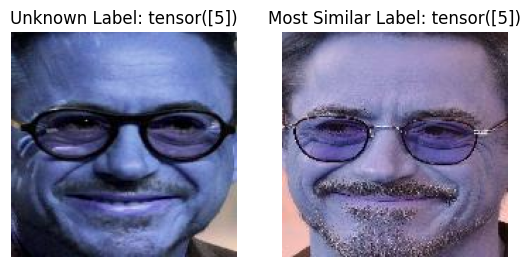

Label is: tensor([5]) and we achived: tensor([5]) the distance is: 0.12849575281143188


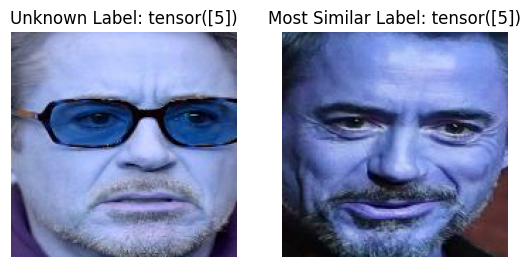

Label is: tensor([5]) and we achived: tensor([5]) the distance is: 0.45028987526893616


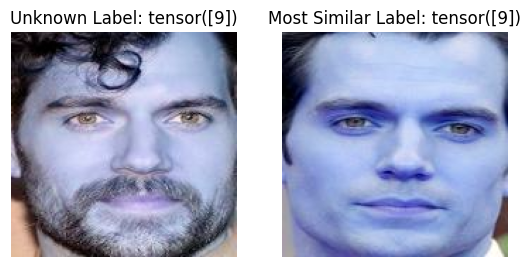

Label is: tensor([9]) and we achived: tensor([9]) the distance is: 0.17679674923419952


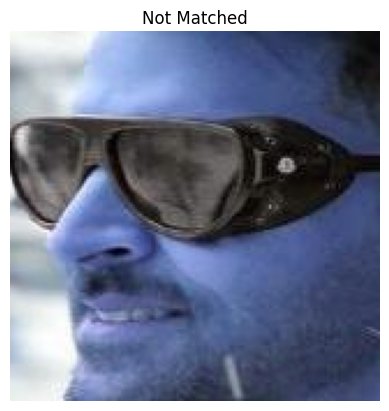

Label is: tensor([3]) and we achived: None the closest is: 0.7534738183021545


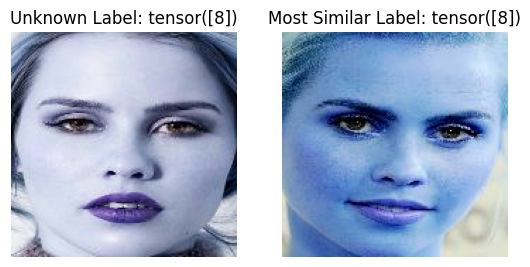

Label is: tensor([8]) and we achived: tensor([8]) the distance is: 0.17043061554431915


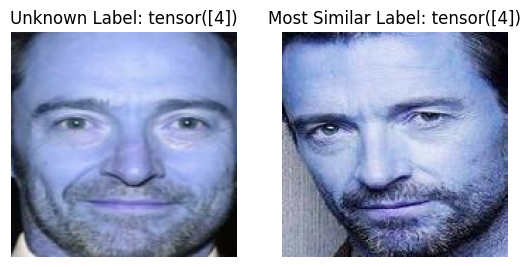

Label is: tensor([4]) and we achived: tensor([4]) the distance is: 0.1299707591533661


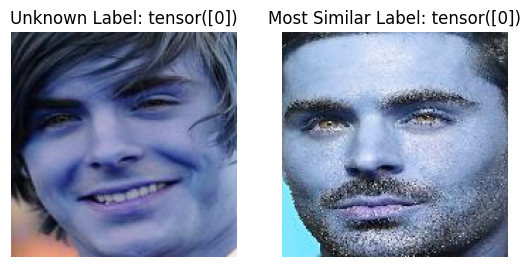

Label is: tensor([0]) and we achived: tensor([0]) the distance is: 0.24210770428180695


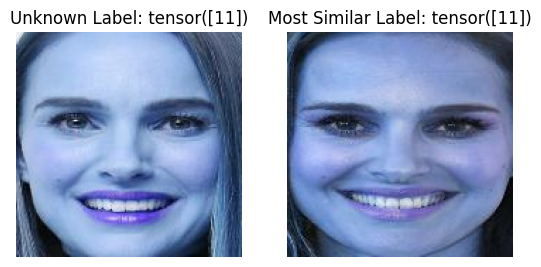

Label is: tensor([11]) and we achived: tensor([11]) the distance is: 0.18857534229755402


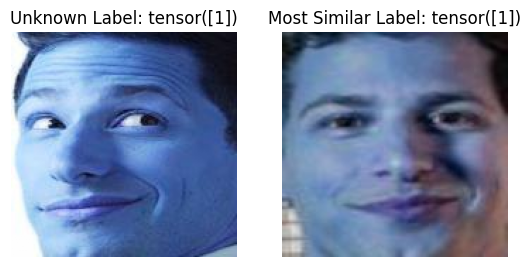

Label is: tensor([1]) and we achived: tensor([1]) the distance is: 0.20115430653095245


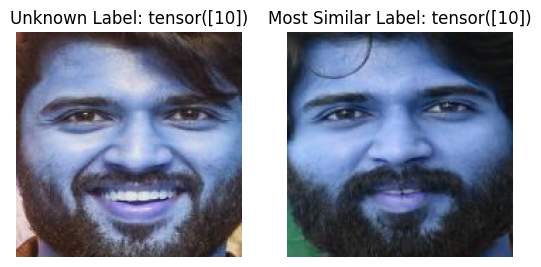

Label is: tensor([10]) and we achived: tensor([10]) the distance is: 0.1308046132326126


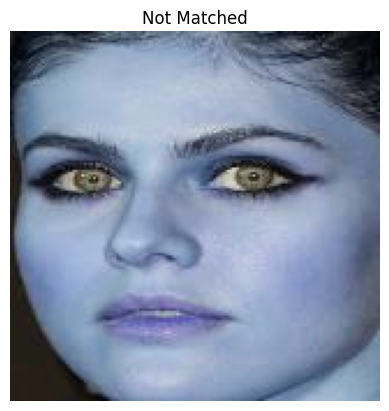

Label is: tensor([6]) and we achived: None the closest is: 0.9095088243484497


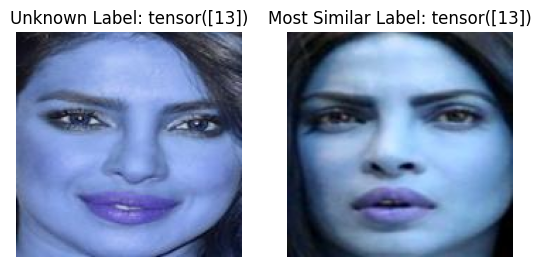

Label is: tensor([13]) and we achived: tensor([13]) the distance is: 0.10973567515611649


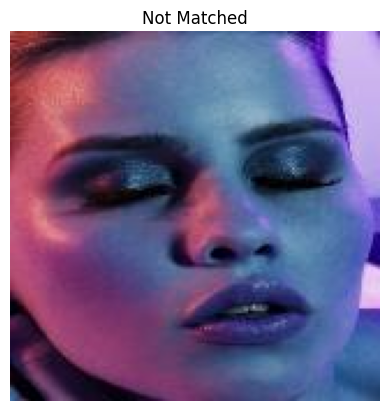

Label is: tensor([8]) and we achived: None the closest is: 0.5018777847290039


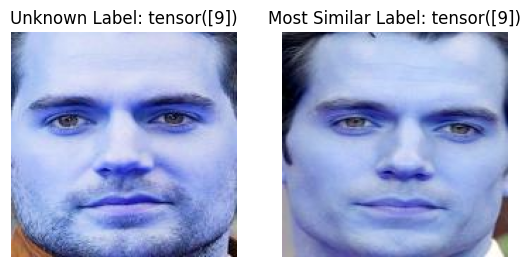

Label is: tensor([9]) and we achived: tensor([9]) the distance is: 0.24419404566287994


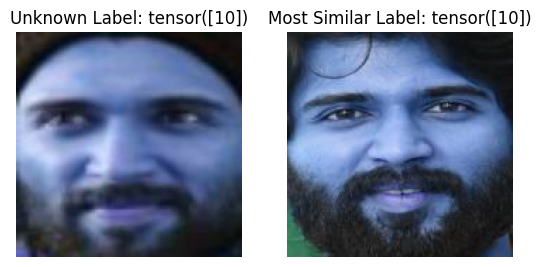

Label is: tensor([10]) and we achived: tensor([10]) the distance is: 0.17716586589813232


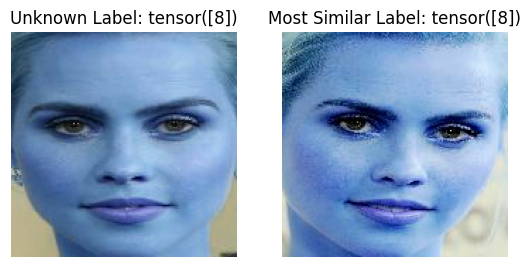

Label is: tensor([8]) and we achived: tensor([8]) the distance is: 0.1093735620379448


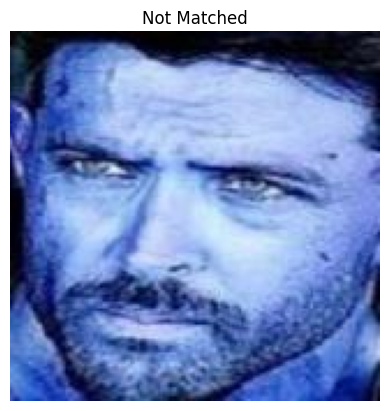

Label is: tensor([3]) and we achived: None the closest is: 1.061587929725647


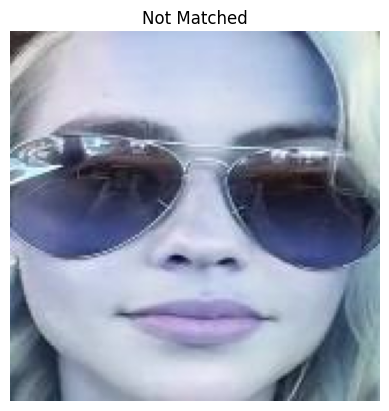

Label is: tensor([8]) and we achived: None the closest is: 0.7790421843528748


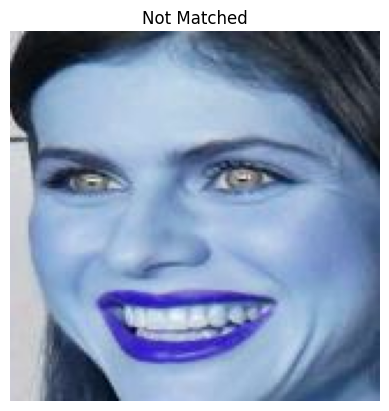

Label is: tensor([6]) and we achived: None the closest is: 0.9196437001228333


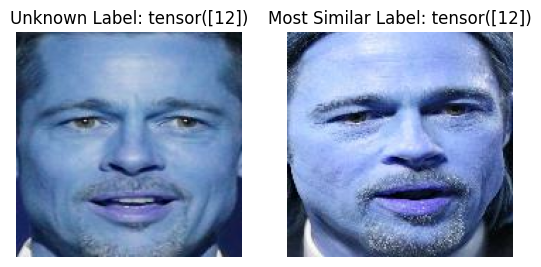

Label is: tensor([12]) and we achived: tensor([12]) the distance is: 0.22317664325237274


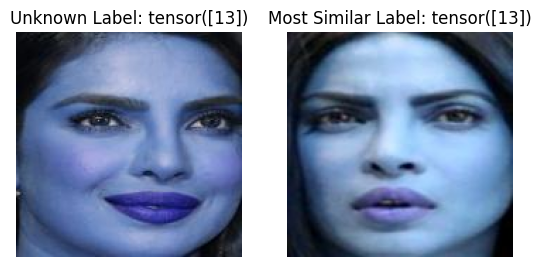

Label is: tensor([13]) and we achived: tensor([13]) the distance is: 0.13877840340137482


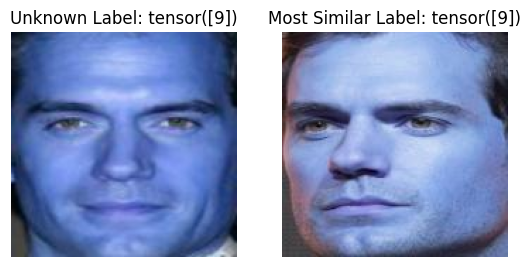

Label is: tensor([9]) and we achived: tensor([9]) the distance is: 0.2562403976917267


In [ ]:
most_similar_image = None
most_similar_label = None
min_dist = 10000000

for unknown_image, unknown_label in unknown_data:
    unknown_embedding = calculate_embedding(unknown_image, model_finetune2)
    for known_image, known_label in known_data:
        known_embedding = calculate_embedding(known_image, model_finetune2)
        temp_sim = torch.norm(unknown_embedding - known_embedding)
        temp_sim = float(temp_sim)
        if min_dist> temp_sim:
          most_similar_image = known_image
          most_similar_label = known_label
          min_dist = temp_sim

    unknown_image_np = unknown_image.squeeze().permute(1, 2, 0).cpu().numpy()
    most_similar_image_np = most_similar_image.squeeze().permute(1, 2, 0).cpu().numpy()
    if min_dist < 0.5:
        fig, axes = plt.subplots(1, 2)
        axes[0].imshow(unknown_image_np)
        axes[0].set_title(f'Unknown Label: {unknown_label}')
        axes[0].axis('off')
        axes[1].imshow(most_similar_image_np)
        axes[1].set_title(f'Most Similar Label: {most_similar_label}')
        axes[1].axis('off')
        plt.show()
        print(f'Label is: {unknown_label} and we achived: {most_similar_label} the distance is: {min_dist}')
    else:
        plt.imshow(unknown_image_np, cmap='gray')  # Adjust the colormap as needed
        plt.title(f'Not Matched')
        plt.axis('off')
        plt.show()
        print(f'Label is: {unknown_label} and we achived: None the closest is: {min_dist}')
    most_similar_image = None
    most_similar_label = None
    min_dist = 1000000


# Cosine

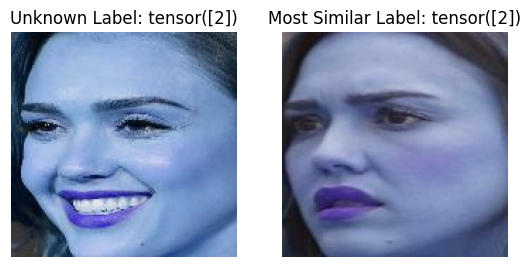

Label is: tensor([2]) and we achived: tensor([2]) the similarity is: 0.9885276556015015


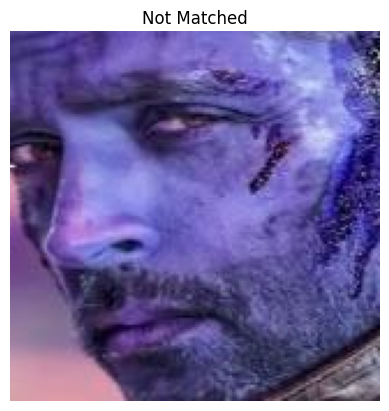

Label is: tensor([3]) and we achived: None the highest similarity is: 0.5283603668212891


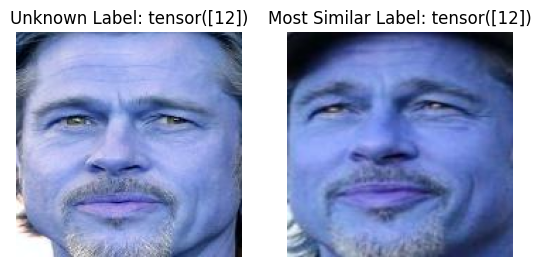

Label is: tensor([12]) and we achived: tensor([12]) the similarity is: 0.9884114265441895


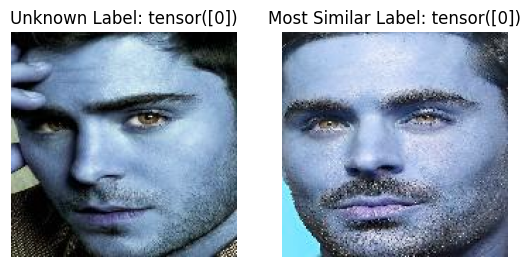

Label is: tensor([0]) and we achived: tensor([0]) the similarity is: 0.9701420068740845


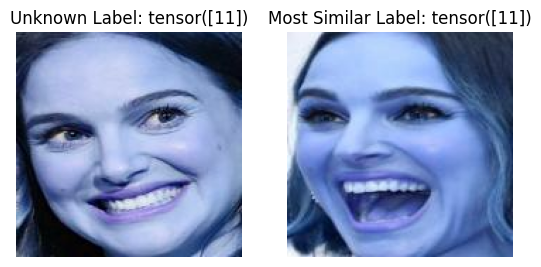

Label is: tensor([11]) and we achived: tensor([11]) the similarity is: 0.9860020279884338


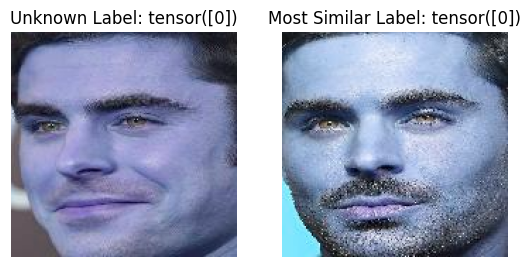

Label is: tensor([0]) and we achived: tensor([0]) the similarity is: 0.9914920330047607


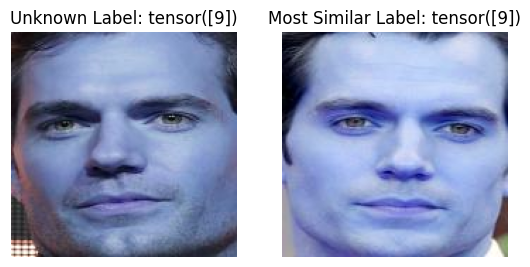

Label is: tensor([9]) and we achived: tensor([9]) the similarity is: 0.9952630400657654


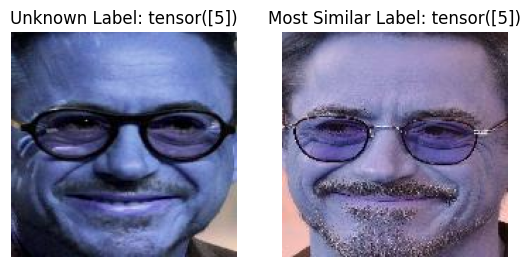

Label is: tensor([5]) and we achived: tensor([5]) the similarity is: 0.9917444586753845


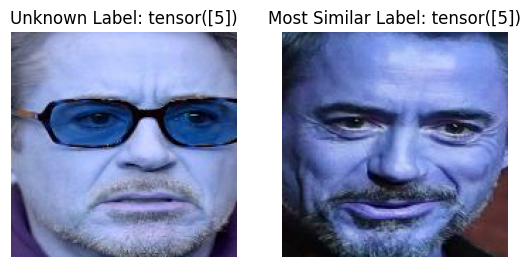

Label is: tensor([5]) and we achived: tensor([5]) the similarity is: 0.8986194729804993


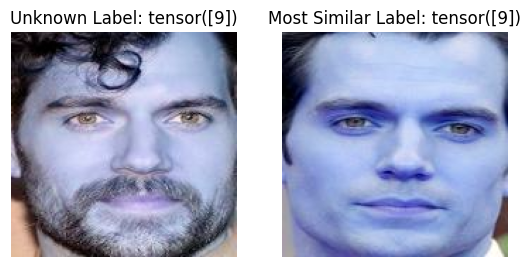

Label is: tensor([9]) and we achived: tensor([9]) the similarity is: 0.9843714833259583


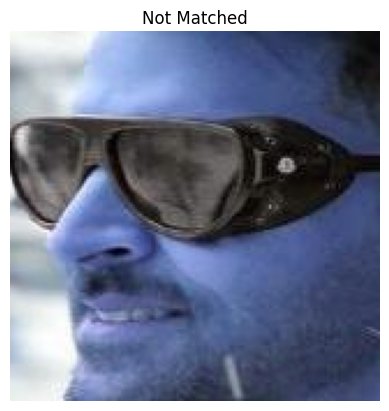

Label is: tensor([3]) and we achived: None the highest similarity is: 0.7161386609077454


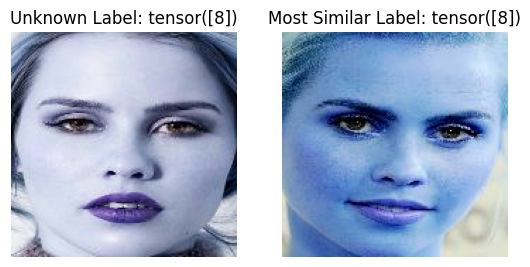

Label is: tensor([8]) and we achived: tensor([8]) the similarity is: 0.9854767322540283


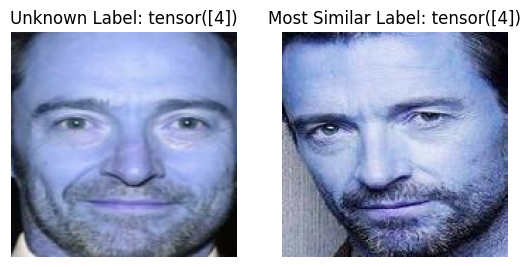

Label is: tensor([4]) and we achived: tensor([4]) the similarity is: 0.9915539026260376


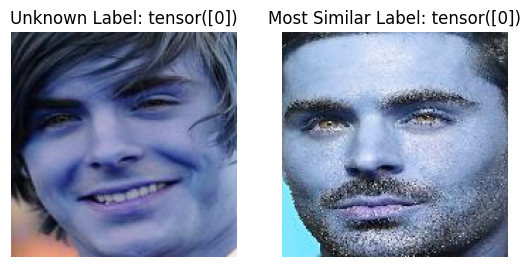

Label is: tensor([0]) and we achived: tensor([0]) the similarity is: 0.9706920385360718


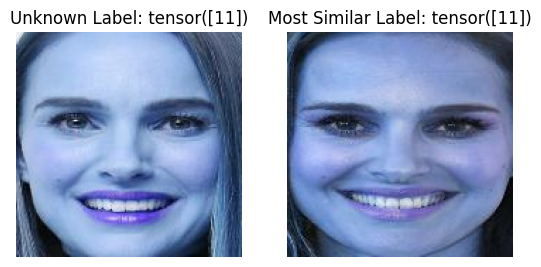

Label is: tensor([11]) and we achived: tensor([11]) the similarity is: 0.9822196960449219


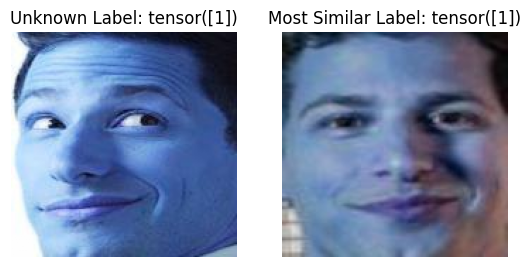

Label is: tensor([1]) and we achived: tensor([1]) the similarity is: 0.9797685146331787


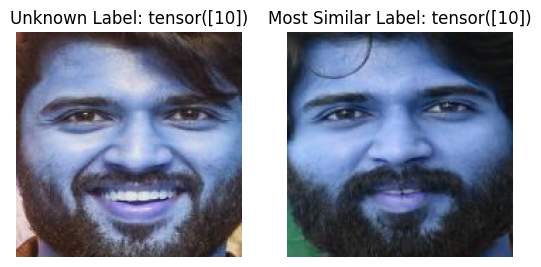

Label is: tensor([10]) and we achived: tensor([10]) the similarity is: 0.9914451837539673


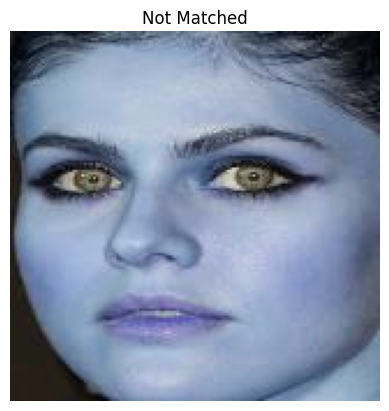

Label is: tensor([6]) and we achived: None the highest similarity is: 0.5863968729972839


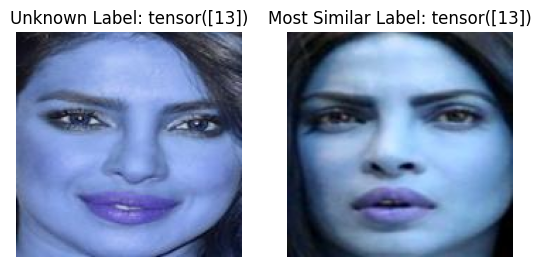

Label is: tensor([13]) and we achived: tensor([13]) the similarity is: 0.9939790964126587


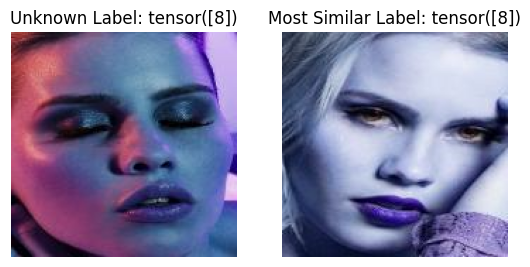

Label is: tensor([8]) and we achived: tensor([8]) the similarity is: 0.8740595579147339


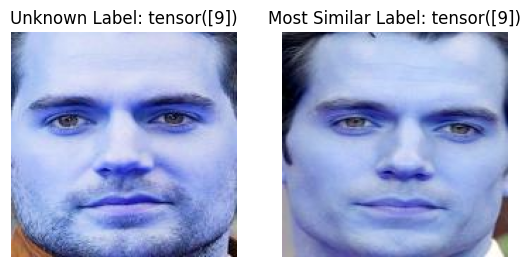

Label is: tensor([9]) and we achived: tensor([9]) the similarity is: 0.9701846241950989


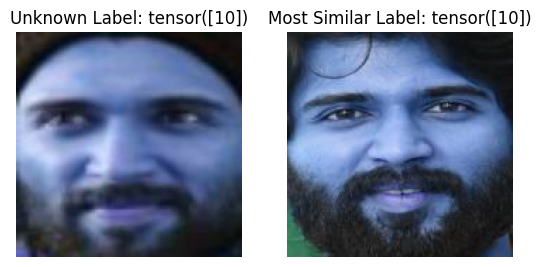

Label is: tensor([10]) and we achived: tensor([10]) the similarity is: 0.984306275844574


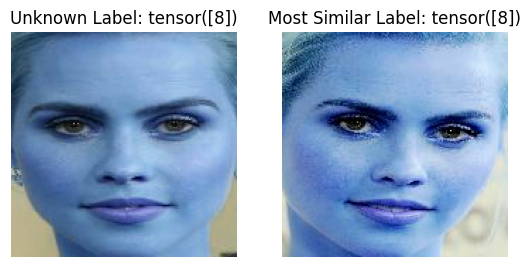

Label is: tensor([8]) and we achived: tensor([8]) the similarity is: 0.9940187335014343


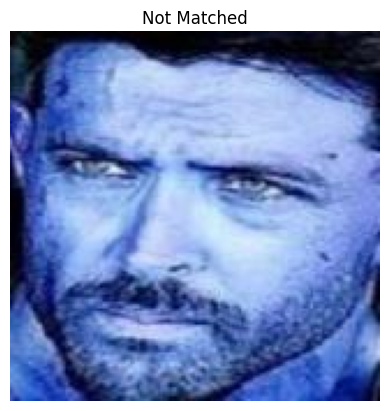

Label is: tensor([3]) and we achived: None the highest similarity is: 0.43651556968688965


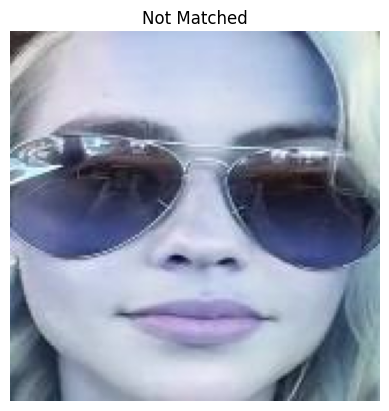

Label is: tensor([8]) and we achived: None the highest similarity is: 0.6965466141700745


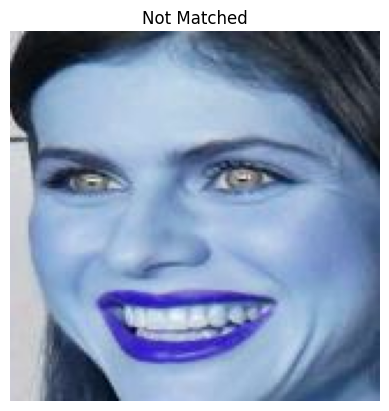

Label is: tensor([6]) and we achived: None the highest similarity is: 0.5771278142929077


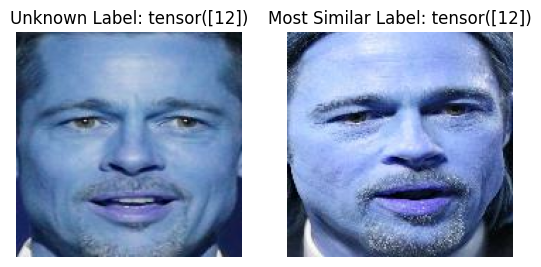

Label is: tensor([12]) and we achived: tensor([12]) the similarity is: 0.9750962257385254


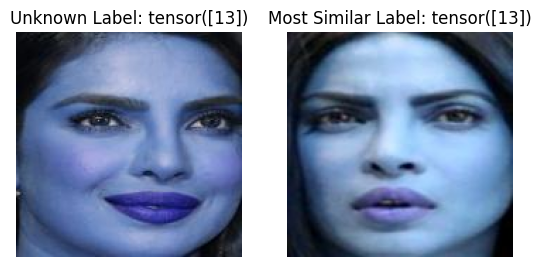

Label is: tensor([13]) and we achived: tensor([13]) the similarity is: 0.9903703331947327


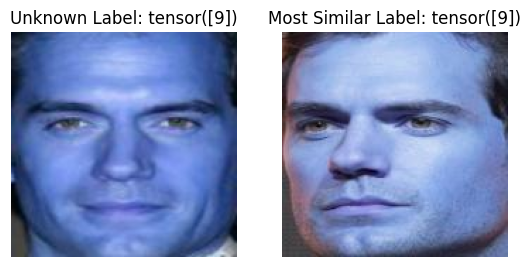

Label is: tensor([9]) and we achived: tensor([9]) the similarity is: 0.9671704173088074


In [ ]:
most_similar_image = None
most_similar_label = None
max_sim = 0

for unknown_image, unknown_label in unknown_data:
    unknown_embedding = calculate_embedding(unknown_image, model_finetune2)
    for known_image, known_label in known_data:
        known_embedding = calculate_embedding(known_image, model_finetune2)

        temp_sim = F.cosine_similarity(unknown_embedding, known_embedding, dim=1)
        temp_sim = float(temp_sim)
        if max_sim < temp_sim :
          most_similar_image = known_image
          most_similar_label = known_label
          max_sim = temp_sim
    unknown_image_np = unknown_image.squeeze().permute(1, 2, 0).cpu().numpy()
    most_similar_image_np = most_similar_image.squeeze().permute(1, 2, 0).cpu().numpy()
    if max_sim>0.8:
      fig, axes = plt.subplots(1, 2)
      axes[0].imshow(unknown_image_np)
      axes[0].set_title(f'Unknown Label: {unknown_label}')
      axes[0].axis('off')
      axes[1].imshow(most_similar_image_np)
      axes[1].set_title(f'Most Similar Label: {most_similar_label}')
      axes[1].axis('off')
      plt.show()
      print(f'Label is: {unknown_label} and we achived: {most_similar_label} the similarity is: {max_sim}')
    else:
      plt.imshow(unknown_image_np, cmap='gray')  # Adjust the colormap as needed
      plt.title(f'Not Matched')
      plt.axis('off')
      plt.show()
      print(f'Label is: {unknown_label} and we achived: None the highest similarity is: {max_sim}')
    most_similar_image = None
    most_similar_label = None
    max_sim = 0


# **Face Verifier Freezed Model**

# Euclidian

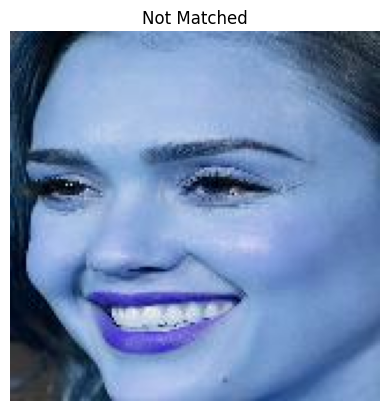

Label is: tensor([2]) and we achived: None the closest is: 0.7781457901000977


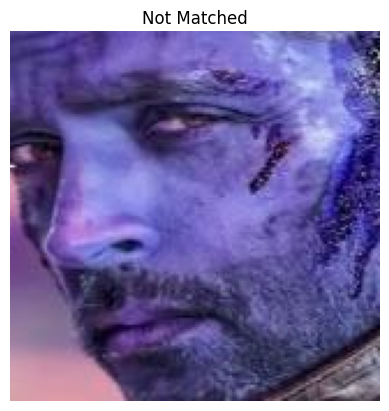

Label is: tensor([3]) and we achived: None the closest is: 1.1478610038757324


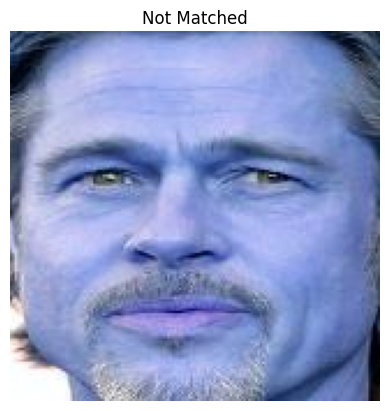

Label is: tensor([12]) and we achived: None the closest is: 0.8435297608375549


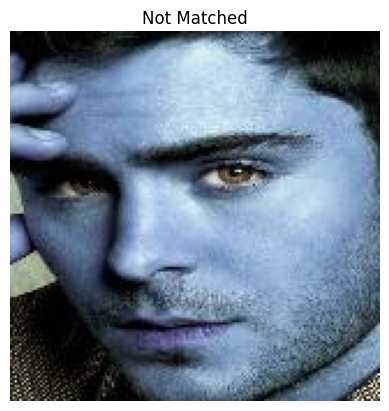

Label is: tensor([0]) and we achived: None the closest is: 1.006920576095581


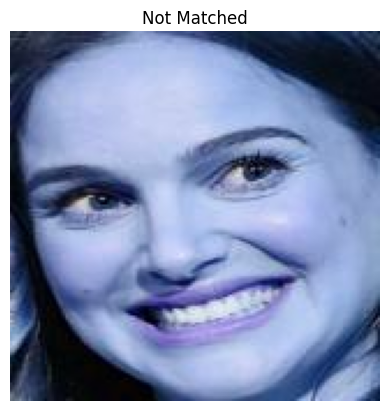

Label is: tensor([11]) and we achived: None the closest is: 0.7825523018836975


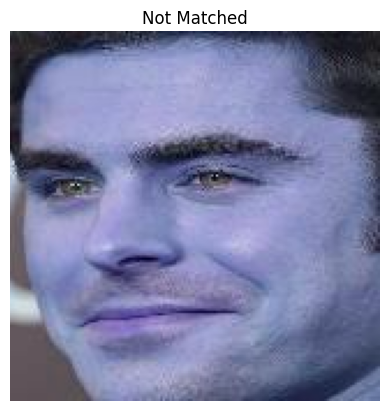

Label is: tensor([0]) and we achived: None the closest is: 1.0621546506881714


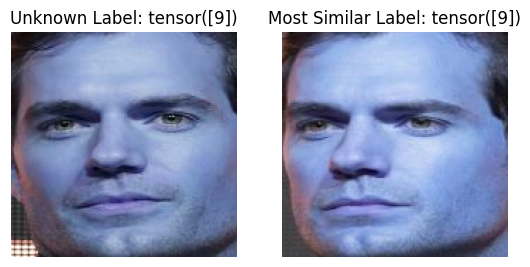

Label is: tensor([9]) and we achived: tensor([9]) the distance is: 0.45547783374786377


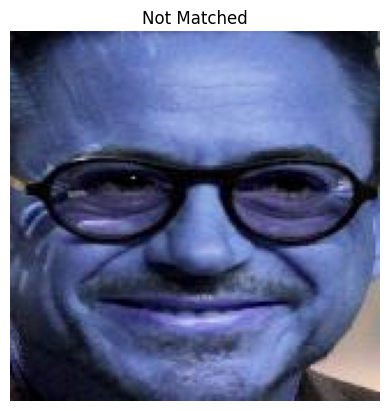

Label is: tensor([5]) and we achived: None the closest is: 1.0914263725280762


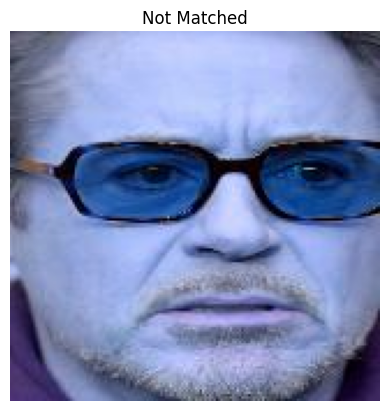

Label is: tensor([5]) and we achived: None the closest is: 1.0512639284133911


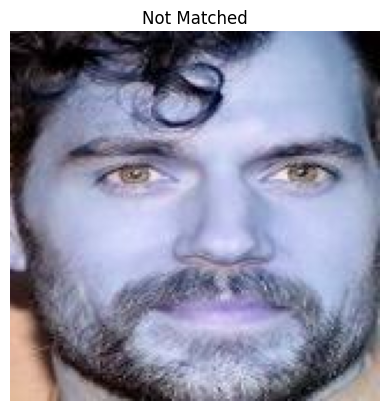

Label is: tensor([9]) and we achived: None the closest is: 0.7975454926490784


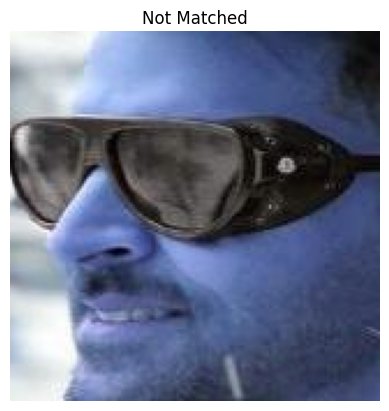

Label is: tensor([3]) and we achived: None the closest is: 1.178085207939148


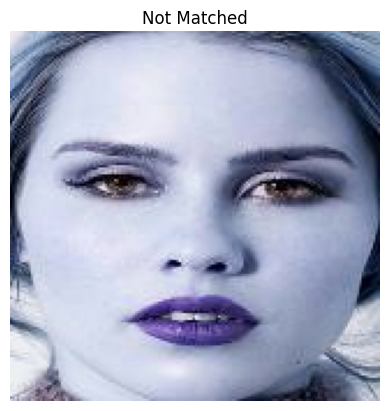

Label is: tensor([8]) and we achived: None the closest is: 0.922418475151062


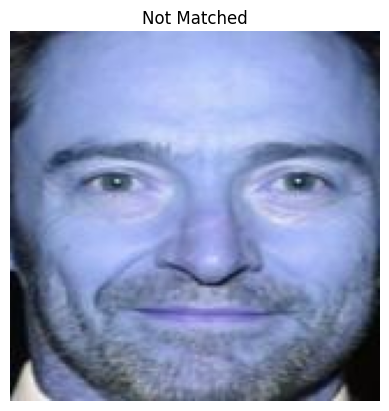

Label is: tensor([4]) and we achived: None the closest is: 1.0264285802841187


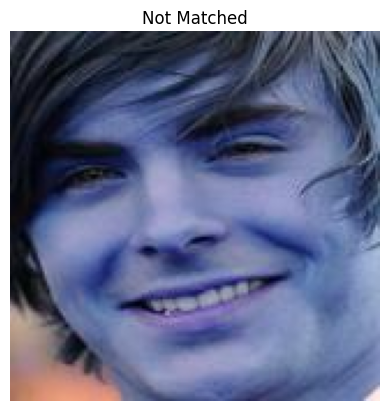

Label is: tensor([0]) and we achived: None the closest is: 1.0592594146728516


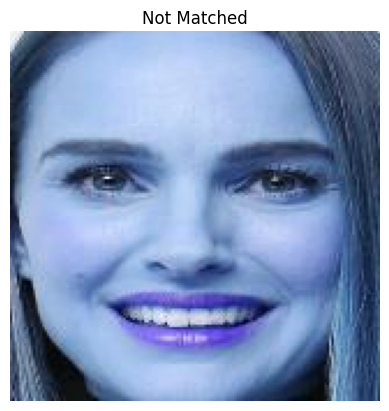

Label is: tensor([11]) and we achived: None the closest is: 0.8808076977729797


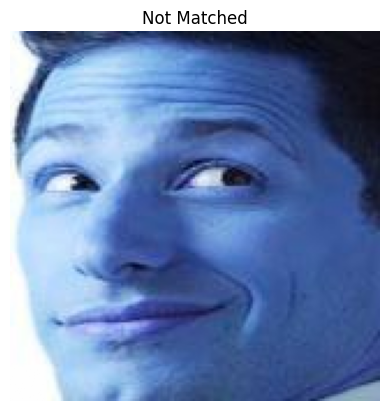

Label is: tensor([1]) and we achived: None the closest is: 0.759490966796875


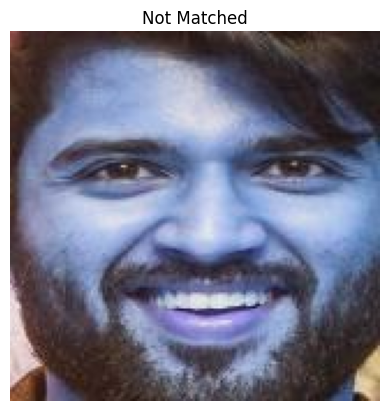

Label is: tensor([10]) and we achived: None the closest is: 0.8686943650245667


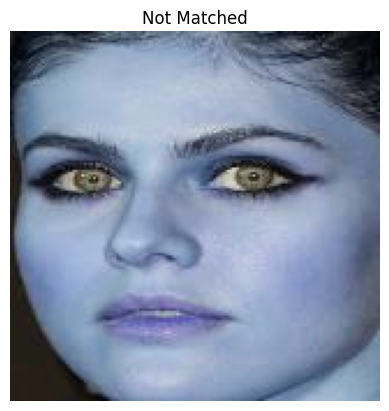

Label is: tensor([6]) and we achived: None the closest is: 1.2788480520248413


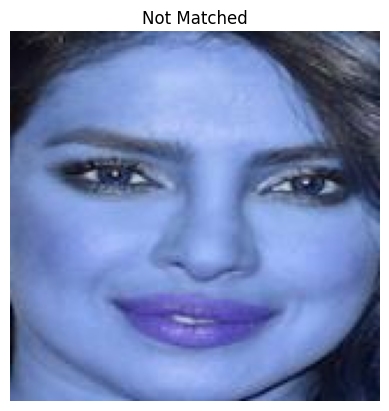

Label is: tensor([13]) and we achived: None the closest is: 0.93887859582901


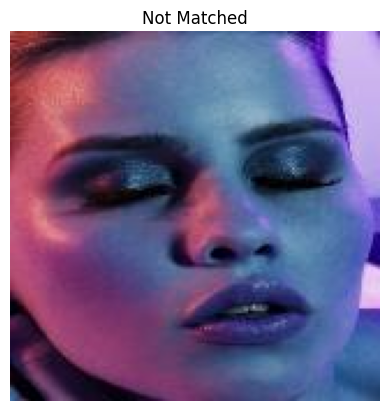

Label is: tensor([8]) and we achived: None the closest is: 1.0909045934677124


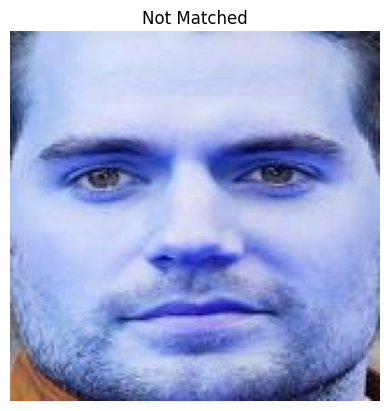

Label is: tensor([9]) and we achived: None the closest is: 0.9566779136657715


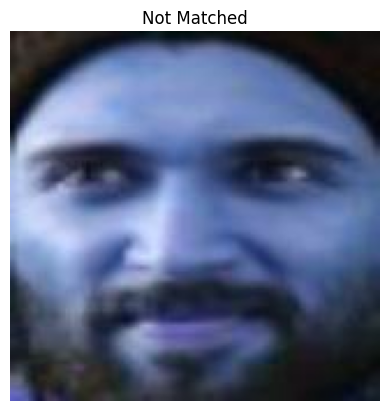

Label is: tensor([10]) and we achived: None the closest is: 0.9962860345840454


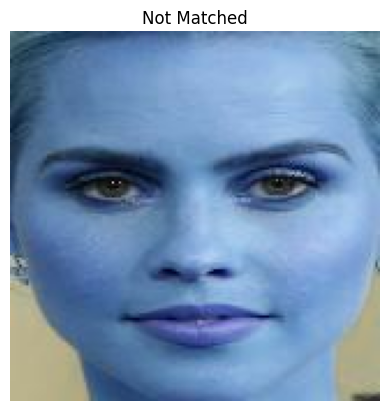

Label is: tensor([8]) and we achived: None the closest is: 0.6363673806190491


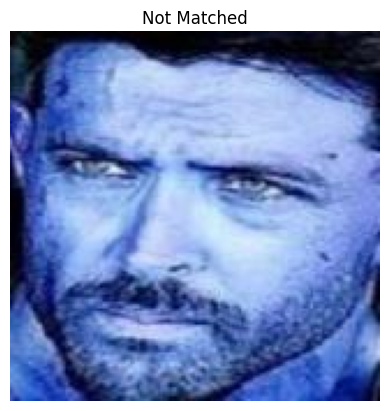

Label is: tensor([3]) and we achived: None the closest is: 1.1380994319915771


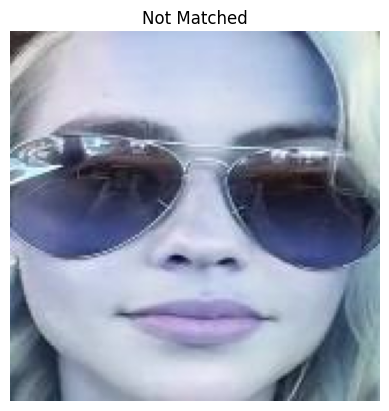

Label is: tensor([8]) and we achived: None the closest is: 1.1039928197860718


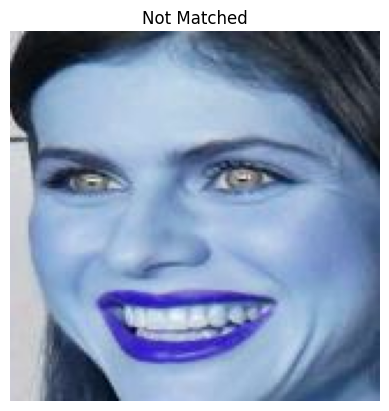

Label is: tensor([6]) and we achived: None the closest is: 1.1783503293991089


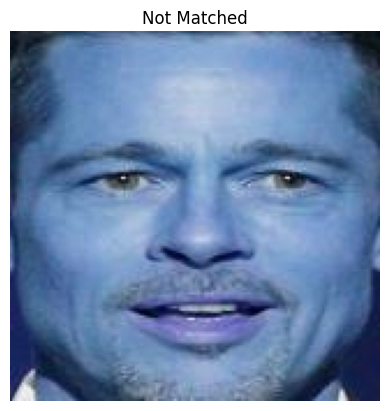

Label is: tensor([12]) and we achived: None the closest is: 0.8744754195213318


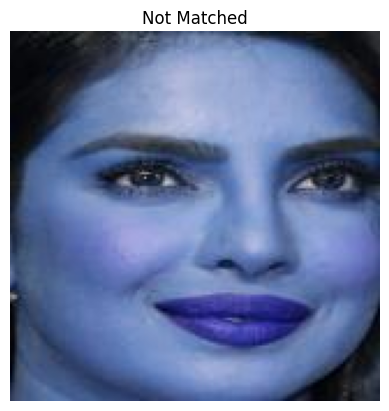

Label is: tensor([13]) and we achived: None the closest is: 1.0306422710418701


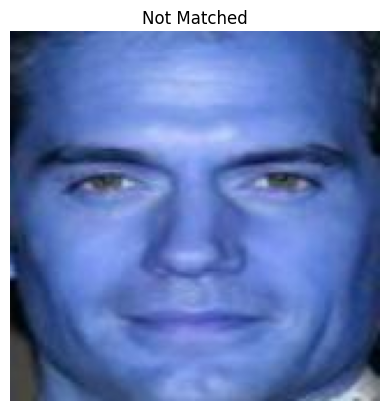

Label is: tensor([9]) and we achived: None the closest is: 0.9590546488761902


In [ ]:
most_similar_image = None
most_similar_label = None
min_dist = 10000000

for unknown_image, unknown_label in unknown_data:
    unknown_embedding = calculate_embedding(unknown_image, model)
    for known_image, known_label in known_data:
        known_embedding = calculate_embedding(known_image, model)
        temp_sim = torch.norm(unknown_embedding - known_embedding)
        temp_sim = float(temp_sim)
        if min_dist> temp_sim:
          most_similar_image = known_image
          most_similar_label = known_label
          min_dist = temp_sim

    unknown_image_np = unknown_image.squeeze().permute(1, 2, 0).cpu().numpy()
    most_similar_image_np = most_similar_image.squeeze().permute(1, 2, 0).cpu().numpy()
    if min_dist < 0.5:
        fig, axes = plt.subplots(1, 2)
        axes[0].imshow(unknown_image_np)
        axes[0].set_title(f'Unknown Label: {unknown_label}')
        axes[0].axis('off')
        axes[1].imshow(most_similar_image_np)
        axes[1].set_title(f'Most Similar Label: {most_similar_label}')
        axes[1].axis('off')
        plt.show()
        print(f'Label is: {unknown_label} and we achived: {most_similar_label} the distance is: {min_dist}')
    else:
        plt.imshow(unknown_image_np, cmap='gray')  # Adjust the colormap as needed
        plt.title(f'Not Matched')
        plt.axis('off')
        plt.show()
        print(f'Label is: {unknown_label} and we achived: None the closest is: {min_dist}')
    most_similar_image = None
    most_similar_label = None
    min_dist = 1000000


# Cosine

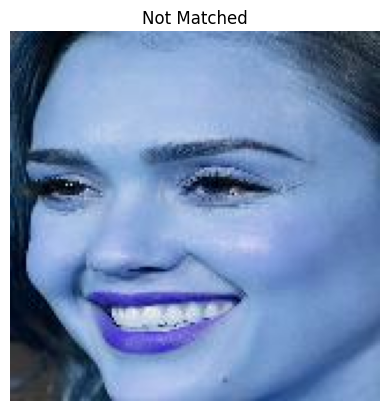

Label is: tensor([2]) and we achived: None the highest similarity is: 0.6972447037696838


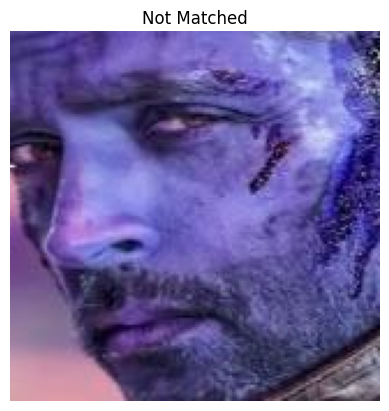

Label is: tensor([3]) and we achived: None the highest similarity is: 0.34120768308639526


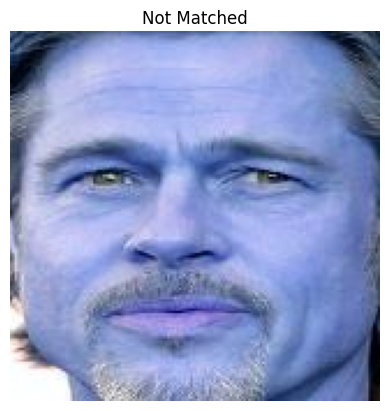

Label is: tensor([12]) and we achived: None the highest similarity is: 0.6442288160324097


In [ ]:
most_similar_image = None
most_similar_label = None
max_sim = 0


for unknown_image, unknown_label in unknown_data:
    unknown_embedding = calculate_embedding(unknown_image, model)
    for known_image, known_label in known_data:
        known_embedding = calculate_embedding(known_image, model)

        temp_sim = F.cosine_similarity(unknown_embedding, known_embedding, dim=1)
        temp_sim = float(temp_sim)
        if max_sim < temp_sim :
          most_similar_image = known_image
          most_similar_label = known_label
          max_sim = temp_sim
    unknown_image_np = unknown_image.squeeze().permute(1, 2, 0).cpu().numpy()
    most_similar_image_np = most_similar_image.squeeze().permute(1, 2, 0).cpu().numpy()
    if max_sim>0.8:
      fig, axes = plt.subplots(1, 2)
      axes[0].imshow(unknown_image_np)
      axes[0].set_title(f'Unknown Label: {unknown_label}')
      axes[0].axis('off')
      axes[1].imshow(most_similar_image_np)
      axes[1].set_title(f'Most Similar Label: {most_similar_label}')
      axes[1].axis('off')
      plt.show()
      print(f'Label is: {unknown_label} and we achived: {most_similar_label} the similarity is: {max_sim}')
    else:
      plt.imshow(unknown_image_np, cmap='gray')  # Adjust the colormap as needed
      plt.title(f'Not Matched')
      plt.axis('off')
      plt.show()
      print(f'Label is: {unknown_label} and we achived: None the highest similarity is: {max_sim}')
    most_similar_image = None
    most_similar_label = None
    max_sim = 0


# **Face Verifier Freezed Model Without Threshold**

Euclidian

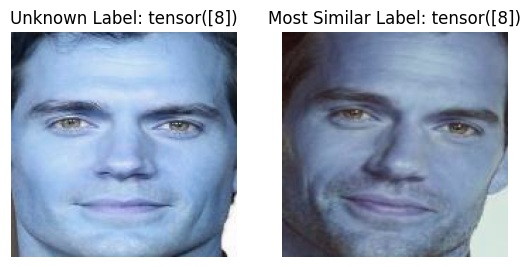

Label is: tensor([8]) and we achived: tensor([8]) the distance is: 1.0082085132598877


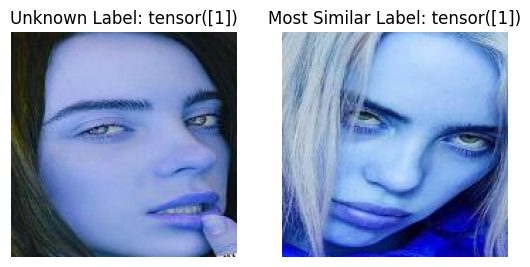

Label is: tensor([1]) and we achived: tensor([1]) the distance is: 0.9970933794975281


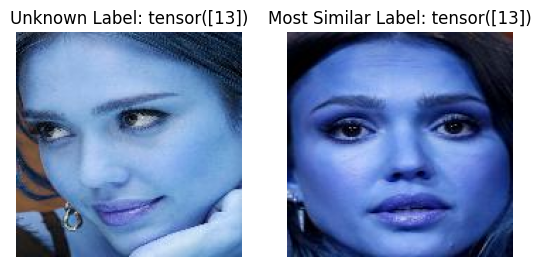

Label is: tensor([13]) and we achived: tensor([13]) the distance is: 0.8869696855545044


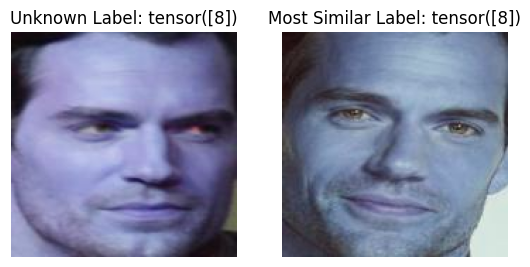

Label is: tensor([8]) and we achived: tensor([8]) the distance is: 1.0857901573181152


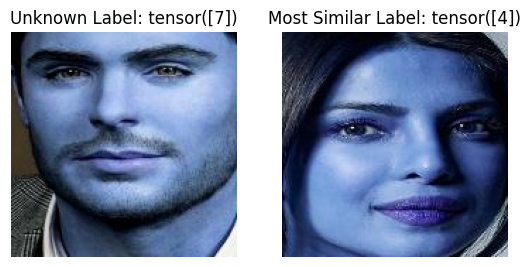

Label is: tensor([7]) and we achived: tensor([4]) the distance is: 1.1677623987197876


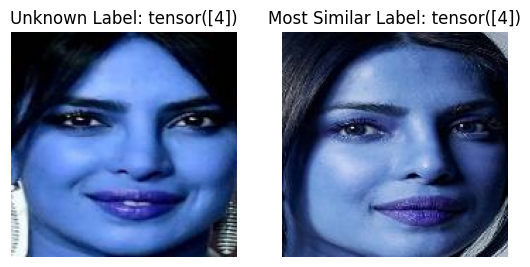

Label is: tensor([4]) and we achived: tensor([4]) the distance is: 0.9099016785621643


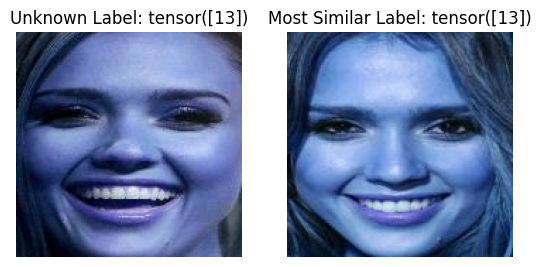

Label is: tensor([13]) and we achived: tensor([13]) the distance is: 0.7646944522857666


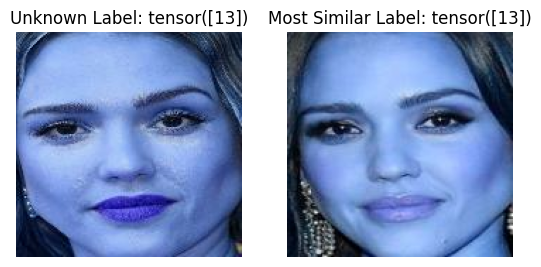

Label is: tensor([13]) and we achived: tensor([13]) the distance is: 0.7661678791046143


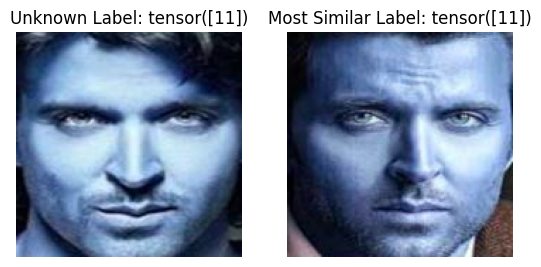

Label is: tensor([11]) and we achived: tensor([11]) the distance is: 0.703774094581604


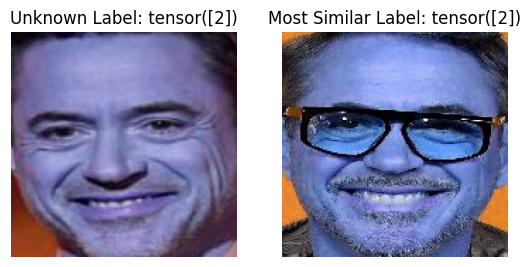

Label is: tensor([2]) and we achived: tensor([2]) the distance is: 0.9728161096572876


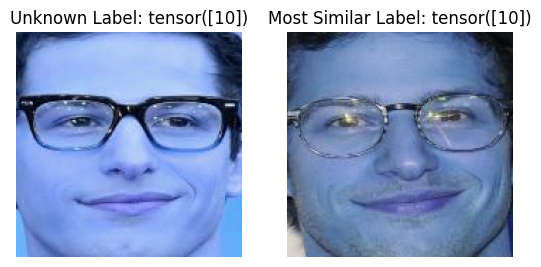

Label is: tensor([10]) and we achived: tensor([10]) the distance is: 0.8921307921409607


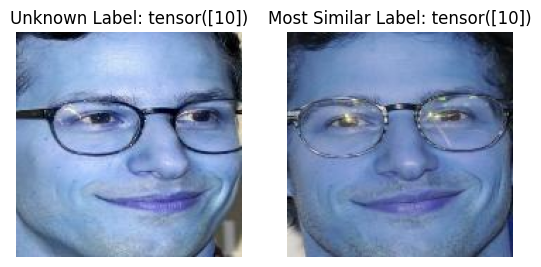

Label is: tensor([10]) and we achived: tensor([10]) the distance is: 0.7790849804878235


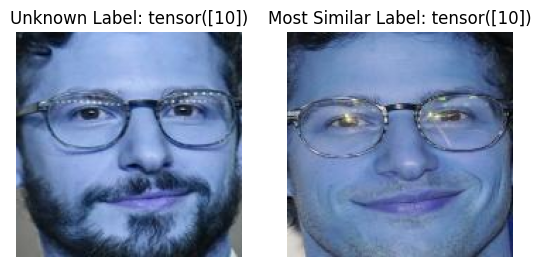

Label is: tensor([10]) and we achived: tensor([10]) the distance is: 1.0525174140930176


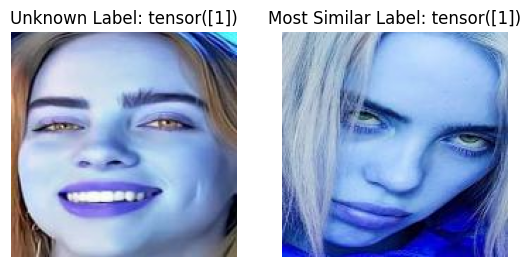

Label is: tensor([1]) and we achived: tensor([1]) the distance is: 1.086733102798462


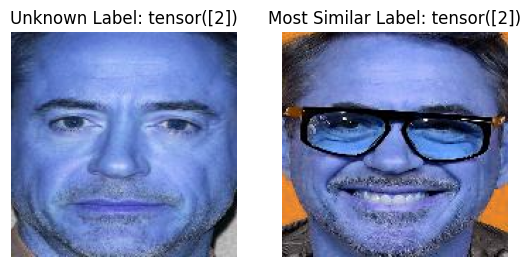

Label is: tensor([2]) and we achived: tensor([2]) the distance is: 1.0717593431472778


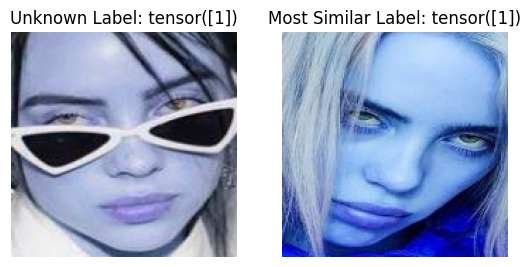

Label is: tensor([1]) and we achived: tensor([1]) the distance is: 1.0025508403778076


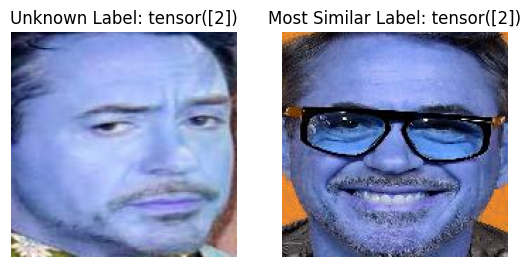

Label is: tensor([2]) and we achived: tensor([2]) the distance is: 0.8957201838493347


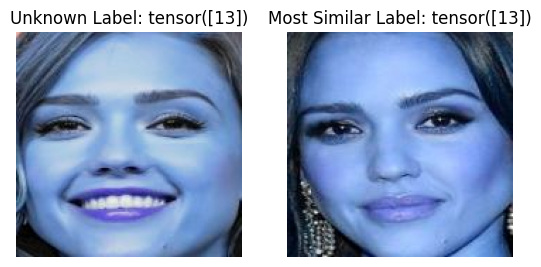

Label is: tensor([13]) and we achived: tensor([13]) the distance is: 0.9048280119895935


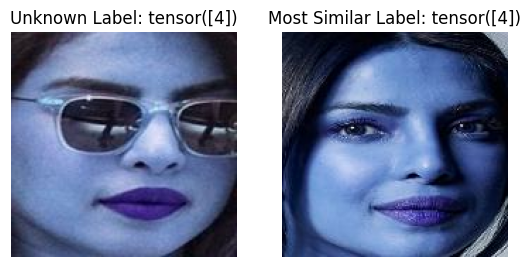

Label is: tensor([4]) and we achived: tensor([4]) the distance is: 1.0588886737823486


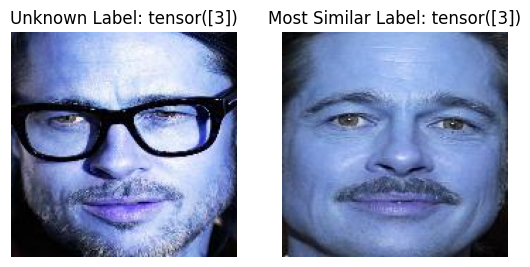

Label is: tensor([3]) and we achived: tensor([3]) the distance is: 1.065907597541809


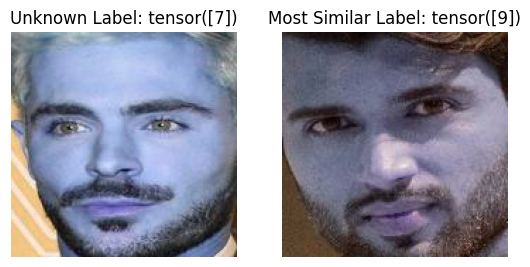

Label is: tensor([7]) and we achived: tensor([9]) the distance is: 1.2609400749206543


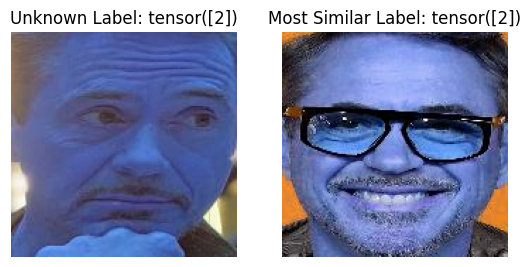

Label is: tensor([2]) and we achived: tensor([2]) the distance is: 1.128481388092041


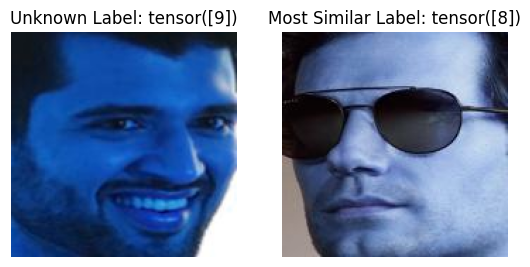

Label is: tensor([9]) and we achived: tensor([8]) the distance is: 1.2285096645355225


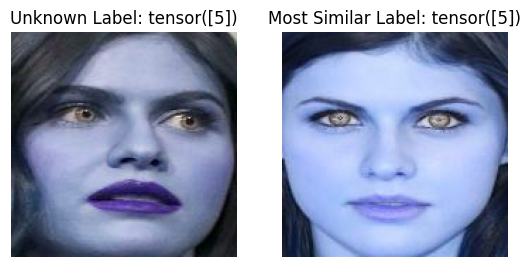

Label is: tensor([5]) and we achived: tensor([5]) the distance is: 1.041015863418579


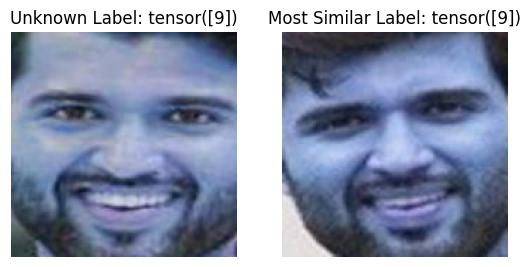

Label is: tensor([9]) and we achived: tensor([9]) the distance is: 0.795055627822876


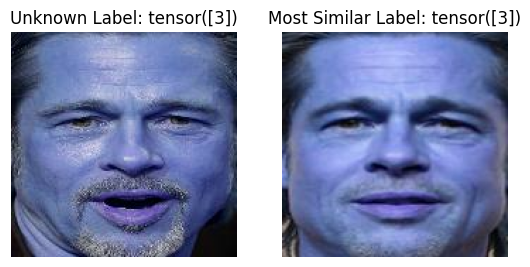

Label is: tensor([3]) and we achived: tensor([3]) the distance is: 0.5110079646110535


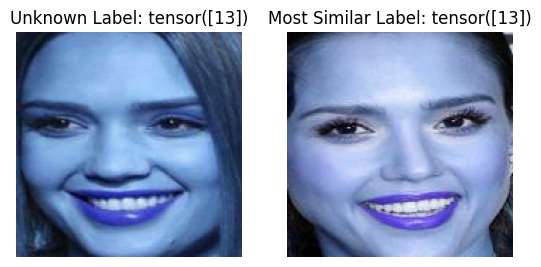

Label is: tensor([13]) and we achived: tensor([13]) the distance is: 0.8685285449028015


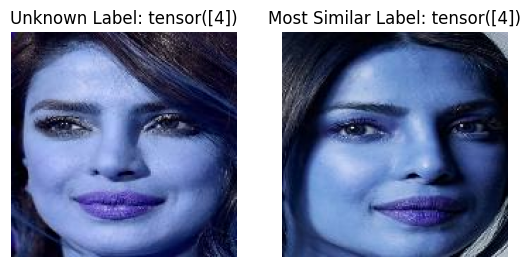

Label is: tensor([4]) and we achived: tensor([4]) the distance is: 0.9257317185401917


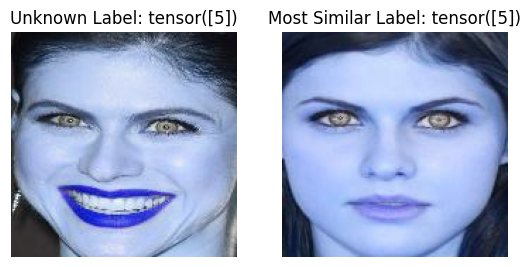

Label is: tensor([5]) and we achived: tensor([5]) the distance is: 0.9184366464614868


In [ ]:
most_similar_image = None
most_similar_label = None
min_dist = 10000000

for unknown_image, unknown_label in unknown_data:
    unknown_embedding = calculate_embedding(unknown_image, model)
    for known_image, known_label in known_data:
        known_embedding = calculate_embedding(known_image, model)
        temp_sim = torch.norm(unknown_embedding - known_embedding)
        temp_sim = float(temp_sim)
        if min_dist> temp_sim:
          most_similar_image = known_image
          most_similar_label = known_label
          min_dist = temp_sim

    unknown_image_np = unknown_image.squeeze().permute(1, 2, 0).cpu().numpy()
    most_similar_image_np = most_similar_image.squeeze().permute(1, 2, 0).cpu().numpy()
    fig, axes = plt.subplots(1, 2)
    axes[0].imshow(unknown_image_np)
    axes[0].set_title(f'Unknown Label: {unknown_label}')
    axes[0].axis('off')
    axes[1].imshow(most_similar_image_np)
    axes[1].set_title(f'Most Similar Label: {most_similar_label}')
    axes[1].axis('off')
    plt.show()
    print(f'Label is: {unknown_label} and we achived: {most_similar_label} the distance is: {min_dist}')

    most_similar_image = None
    most_similar_label = None
    min_dist = 1000000
